In [1]:
import os
import sys
import getpass
import importlib
import tqdm
usrname = getpass.getuser()
sys.path.append('/Users/aghavamp/Desktop/Projects')
sys.path.append('/Users/aghavamp/Desktop/Projects/Functional_Fusion')
sys.path.append('/Users/aghavamp/Desktop/Projects/SUITPy')
sys.path.append('/Users/aghavamp/Desktop/Projects/AnatSearchlight')
sys.path.append(f'/Users/{usrname}/Desktop/Projects/PcmPy')

import AnatSearchlight.searchlight as sl
import scipy.io as sio
import rsatoolbox as rsa
from rsatoolbox.io import spm as spm_io
import matplotlib.pyplot as plt
import matplotlib
import numpy as np
import pandas as pd
import surfAnalysisPy as surf
import SUITPy as suit
import nibabel as nb
from nibabel import cifti2
import nitools as nt
from matplotlib.cm import ScalarMappable
import matplotlib.cm as cm
import matplotlib.colors as mcolors
from pathlib import Path
import seaborn as sns
import PcmPy as pcm
import Functional_Fusion.atlas_map as am
import Functional_Fusion.reliability as rel
import glob
import matplotlib.patches as patches
from nilearn.plotting.cm import _cmap_d as nilearn_cmaps

# SET PATHS:
baseDir = os.path.join('/Users', getpass.getuser(), 'Desktop', 'Projects', 'bimanual_wrist', 'data', 'fMRI')
bidsDir = 'BIDS'
anatomicalDir = 'anatomicals'
freesurferDir = 'surfaceFreesurfer'
surfacewbDir = 'surfaceWB' 
behavDir = 'behavioural'
regDir = 'ROI'
atlasDir = '/Volumes/diedrichsen_data$/data/Atlas_templates/fs_LR_32'
analysisDir = os.path.join(os.path.dirname(os.path.dirname(baseDir)), 'analysis')



## Define searchlight

In [ ]:
sn_list = [101, 102, 103, 104, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115]
glm = 1
hem = ['L', 'R']
sl_name = ['left_cortex', 'right_cortex']
radius = 30
maxvoxels = 200

for sn in sn_list:
    try:
        # define:
        for i, h in enumerate(hem):
            mySearchlight = sl.SearchlightSurface(sl_name[i])
            surfaces = [os.path.join(baseDir, surfacewbDir, f's{sn}', f's{sn}.{h}.pial.32k.surf.gii'),
                        os.path.join(baseDir, surfacewbDir, f's{sn}', f's{sn}.{h}.white.32k.surf.gii')]
            mask = os.path.join(baseDir, f'glm{glm}', f's{sn}', 'mask.nii') # Mask in functional space for the subject
            
            # search light define:
            mySearchlight.define(surfaces,mask,maxradius=radius,maxvoxels=maxvoxels)
            mySearchlight.save(os.path.join(analysisDir,'searchlight',f'sl_{h}_s{sn}.h5'))
    
    except Exception as e:
        print(f"Error processing subject {sn}, hemisphere {h}: {e}")
        continue




Processing center 0 of 32492
Processing center 1000 of 32492
Processing center 2000 of 32492
Processing center 3000 of 32492
Processing center 4000 of 32492
Processing center 5000 of 32492
Processing center 6000 of 32492
Processing center 7000 of 32492
Processing center 8000 of 32492
Processing center 9000 of 32492
Processing center 10000 of 32492
Processing center 11000 of 32492
Processing center 12000 of 32492
Processing center 13000 of 32492
Processing center 14000 of 32492
Processing center 15000 of 32492
Processing center 16000 of 32492
Processing center 17000 of 32492
Processing center 18000 of 32492
Processing center 19000 of 32492
Processing center 20000 of 32492
Processing center 21000 of 32492
Processing center 22000 of 32492
Processing center 23000 of 32492
Processing center 24000 of 32492
Processing center 25000 of 32492
Processing center 26000 of 32492
Processing center 27000 of 32492
Processing center 28000 of 32492
Processing center 29000 of 32492
Processing center 30000

## Run mean beta searchlight

In [2]:
sn_list = [101, 102, 103, 104, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115]
glm = 1
hem = ['L', 'R']
sl_name = ['left_cortex', 'right_cortex']
conds = ['lhand', 'rhand', 'bi']

def mean_function(data):
    # mean_voxels = np.mean(data, axis=1)
    # mean_beta = np.mean(mean_voxels, axis=0)
    # std_beta = np.std(mean_voxels, axis=0, ddof=1)
    # # t statistics:
    # t_stats = (mean_beta) / (std_beta / np.sqrt(len(mean_voxels)))

    mean_beta = np.nanmean(data[:-1, :])

    return mean_beta

for sn in sn_list:
    try:
        # run mean:
        for cond in conds:
                # regressor info:
                reginfo = pd.read_table(os.path.join(baseDir, f'glm{glm}', f's{sn}', 'reginfo.tsv'))
                # get indices of the regressors of interest:
                regressors_of_interest = reginfo[reginfo.name.str.contains(cond)].index.tolist()

                datafiles = [os.path.join(baseDir, f'glm{glm}', f's{sn}', f'beta_{i+1:04d}.nii') for i in regressors_of_interest]
                datafiles.append(os.path.join(baseDir, f'glm{glm}', f's{sn}', 'ResMS.nii'))
                
                for i, h in enumerate(hem):
                        S = sl.load(os.path.join(analysisDir,'searchlight',f'sl_{h}_s{sn}.h5'))
                        results = S.run(datafiles, mean_function, verbose=False)
                        S.data_to_cifti(results, outfilename=os.path.join(baseDir, 'searchlight', f'glm{glm}_{cond}_s{sn}_{h}_cortex.dscalar.nii'))

    except Exception as e:
        print(f"Error processing subject {sn}, {e}")
        continue




## Run MVPA searchlight

In [6]:
sn_list = [101, 102, 103, 104, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115]
sn_list = [101]
glm = 1
hem = ['L', 'R']
sl_name = ['left_cortex', 'right_cortex']
conds = ['lhand', 'rhand', 'bi']

def mvpa_function(data, **kwargs):
    Y = data[:-1, :] / np.sqrt(data[-1,:])
    partition_vec = kwargs['partition_vec']
    condition_vec = kwargs['condition_vec']
    
    # estimate G matrix:
    G_hat,_ = pcm.est_G_crossval(Y,
                    condition_vec,
                    partition_vec,
                    X=pcm.matrix.indicator(partition_vec))
    
    D = pcm.G_to_dist(G_hat)
    n = D.shape[0]
    out = np.sum(D) / (n**2 - n)
    # mean of distances:
    return out

for sn in sn_list:
    # run MVPA:
    for cond in conds:
        print(f'Processing subject {sn}, condition {cond}...')
        # regressor info:
        reginfo = pd.read_table(os.path.join(baseDir, f'glm{glm}', f's{sn}', 'reginfo.tsv'))
        # get indices of the regressors of interest:
        regressors_of_interest = reginfo[(reginfo.name.str.contains(cond))].index.tolist()
        
        datafiles = [os.path.join(baseDir, f'glm{glm}', f's{sn}', f'beta_{i+1:04d}.nii') for i in regressors_of_interest]
        datafiles.append(os.path.join(baseDir, f'glm{glm}', f's{sn}', 'ResMS.nii'))
        partition_vec = reginfo.loc[regressors_of_interest, 'run'].values
        condition_vec = reginfo.loc[regressors_of_interest, 'name'].values

        for i, h in enumerate(hem):
            S = sl.load(os.path.join(analysisDir,'searchlight',f'sl_{h}_s{sn}.h5'))
            results = S.run_parallel(datafiles, mvpa_function, {'partition_vec': partition_vec, 'condition_vec': condition_vec}, verbose=False)
            S.data_to_cifti(results, outfilename=os.path.join(baseDir, 'searchlight', f'glm{glm}_mvpa_{cond}_s{sn}_{h}_cortex.dscalar.nii'))



Processing subject 101, condition lhand...


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 14 concurrent workers.
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done  22 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 428 tasks      | elapsed:    3.3s
[Parallel(n_jobs=-1)]: Done 1328 tasks      | elapsed:    4.6s
[Parallel(n_jobs=-1)]: Done 2228 tasks      | elapsed:    6.0s
[Parallel(n_jobs=-1)]: Done 3328 tasks      | elapsed:    7.7s
[Parallel(n_jobs=-1)]: Done 4428 tasks      | elapsed:    9.4s
[Parallel(n_jobs=-1)]: Done 5728 tasks      | elapsed:   11.5s
[Parallel(n_jobs=-1)]: Done 7028 tasks      | elapsed:   13.4s
[Parallel(n_jobs=-1)]: Done 8528 tasks      | elapsed:   15.7s
[Parallel(n_jobs=-1)]: Done 10028 tasks      | elapsed:   18.0s
[Parallel(n_jobs=-1)]: Done 11728 tasks      | elapsed:   20.6s
[Parallel(n_jobs=-1)]: Done 13428 tasks      | elapsed:   23.2s
[Parallel(n_jobs=-1)]: Done 15328 tasks      | elapsed:   26.1s
[Parallel(n_jobs=-1)]: Done 17228 tasks 

Processing subject 101, condition rhand...


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 14 concurrent workers.
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done  22 tasks      | elapsed:    1.9s
[Parallel(n_jobs=-1)]: Done 428 tasks      | elapsed:    3.1s
[Parallel(n_jobs=-1)]: Done 1328 tasks      | elapsed:    4.8s
[Parallel(n_jobs=-1)]: Done 2228 tasks      | elapsed:    6.2s
[Parallel(n_jobs=-1)]: Done 3328 tasks      | elapsed:    8.0s
[Parallel(n_jobs=-1)]: Done 4428 tasks      | elapsed:    9.8s
[Parallel(n_jobs=-1)]: Done 5728 tasks      | elapsed:   11.9s
[Parallel(n_jobs=-1)]: Done 7028 tasks      | elapsed:   14.1s
[Parallel(n_jobs=-1)]: Done 8528 tasks      | elapsed:   16.6s
[Parallel(n_jobs=-1)]: Done 10028 tasks      | elapsed:   19.1s
[Parallel(n_jobs=-1)]: Done 11728 tasks      | elapsed:   21.8s
[Parallel(n_jobs=-1)]: Done 13428 tasks      | elapsed:   24.6s
[Parallel(n_jobs=-1)]: Done 15328 tasks      | elapsed:   27.7s
[Parallel(n_jobs=-1)]: Done 17228 tasks 

Processing subject 101, condition bi...


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 14 concurrent workers.
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done  22 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 428 tasks      | elapsed:    4.0s
[Parallel(n_jobs=-1)]: Done 1328 tasks      | elapsed:    5.6s
[Parallel(n_jobs=-1)]: Done 2228 tasks      | elapsed:    7.1s
[Parallel(n_jobs=-1)]: Done 3328 tasks      | elapsed:    9.0s
[Parallel(n_jobs=-1)]: Done 4428 tasks      | elapsed:   11.0s
[Parallel(n_jobs=-1)]: Done 5728 tasks      | elapsed:   13.3s
[Parallel(n_jobs=-1)]: Done 7028 tasks      | elapsed:   15.5s
[Parallel(n_jobs=-1)]: Done 8528 tasks      | elapsed:   18.2s
[Parallel(n_jobs=-1)]: Done 10028 tasks      | elapsed:   20.6s
[Parallel(n_jobs=-1)]: Done 11728 tasks      | elapsed:   22.8s
[Parallel(n_jobs=-1)]: Done 13428 tasks      | elapsed:   26.6s
[Parallel(n_jobs=-1)]: Done 15328 tasks      | elapsed:   29.8s
[Parallel(n_jobs=-1)]: Done 17228 tasks 

## Marginal left hand bimanual searchlight

In [2]:
sn_list = [101, 102, 103, 104, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115]
glm = 1
hem = ['L', 'R']
sl_name = ['left_cortex', 'right_cortex']

def mvpa_marginal_lhand_function(data, **kwargs):
        Y_all = data[:-1,:] / np.sqrt(data[-1,:])
        partitions_all = kwargs['partition_vec']
        conditions_all = kwargs['condition_vec']
        
        # define the structure of the averaged data:
        angles = [0, 60, 120, 180, 240, 300]
        partitions = np.unique(partitions_all)
        conditions = angles.copy()
        Y = np.zeros((len(partitions)*len(conditions), Y_all.shape[1]))
        partition_vec = np.repeat(partitions, len(conditions))
        condition_vec = np.tile(conditions, len(partitions))
        
        # average the activity patterns and place into Y:
        for i in range(Y.shape[0]):
            what_partition = partition_vec[i]
            what_condition = condition_vec[i]

            name = f'bi:{what_condition}'
            rows = [j for j, c in enumerate(conditions_all) if name in c and partitions_all[j] == what_partition]

            # average the activity patterns:
            Y[i, :] = np.mean(Y_all[rows, :], axis=0)
            
        # estimate the G matrix:
        G_hat,_ = pcm.est_G_crossval(Y,
                        condition_vec,
                        partition_vec,
                        X=pcm.matrix.indicator(partition_vec))
        
        D = pcm.G_to_dist(G_hat)
        n = D.shape[0]
        
        # mean of distances:
        return np.sum(D)/(n**2 - n)

for sn in sn_list:
    try:
        # run marginal MVPA:
        # regressor info:
        reginfo = pd.read_table(os.path.join(baseDir, f'glm{glm}', f's{sn}', 'reginfo.tsv'))
        # get indices of the regressors of interest:
        regressors_of_interest = reginfo[reginfo.name.str.contains('bi')].index.tolist()

        datafiles = [os.path.join(baseDir, f'glm{glm}', f's{sn}', f'beta_{i+1:04d}.nii') for i in regressors_of_interest]
        datafiles.append(os.path.join(baseDir, f'glm{glm}', f's{sn}', 'ResMS.nii'))
        partition_vec = reginfo.loc[regressors_of_interest, 'run'].values
        condition_vec = reginfo.loc[regressors_of_interest, 'name'].values

        for i, h in enumerate(hem):
            S = sl.load(os.path.join(analysisDir,'searchlight',f'sl_{h}_s{sn}.h5'))
            results = S.run(datafiles, mvpa_marginal_lhand_function, {'partition_vec': partition_vec, 'condition_vec': condition_vec})
            S.data_to_cifti(results, outfilename=os.path.join(baseDir, 'searchlight', f'glm{glm}_marginal_lhand_s{sn}_{h}_cortex.dscalar.nii'))
    
    except:
            print(f'Error processing subject {sn}. Skipping...')
            continue



Loading data 
Volume number 1
Volume number 2
Volume number 3
Volume number 4
Volume number 5
Volume number 6
Volume number 7
Volume number 8
Volume number 9
Volume number 10
Volume number 11
Volume number 12
Volume number 13
Volume number 14
Volume number 15
Volume number 16
Volume number 17
Volume number 18
Volume number 19
Volume number 20
Volume number 21
Volume number 22
Volume number 23
Volume number 24
Volume number 25
Volume number 26
Volume number 27
Volume number 28
Volume number 29
Volume number 30
Volume number 31
Volume number 32
Volume number 33
Volume number 34
Volume number 35
Volume number 36
Volume number 37
Volume number 38
Volume number 39
Volume number 40
Volume number 41
Volume number 42
Volume number 43
Volume number 44
Volume number 45
Volume number 46
Volume number 47
Volume number 48
Volume number 49
Volume number 50
Volume number 51
Volume number 52
Volume number 53
Volume number 54
Volume number 55
Volume number 56
Volume number 57
Volume number 58
Volume nu

## Marginal right hand bimanual searchlight

In [3]:
sn_list = [101, 102, 103, 104, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115]
glm = 1
hem = ['L', 'R']
sl_name = ['left_cortex', 'right_cortex']

def mvpa_marginal_rhand_function(data, **kwargs):
        Y_all = data[:-1,:] / np.sqrt(data[-1,:])
        partitions_all = kwargs['partition_vec']
        conditions_all = kwargs['condition_vec']

        # define the structure of the averaged data:
        angles = [0, 60, 120, 180, 240, 300]
        partitions = np.unique(partitions_all)
        conditions = angles.copy()
        Y = np.zeros((len(partitions)*len(conditions), Y_all.shape[1]))
        partition_vec = np.repeat(partitions, len(conditions))
        condition_vec = np.tile(conditions, len(partitions))
        
        # average the activity patterns and place into Y:
        for i in range(Y.shape[0]):
            what_partition = partition_vec[i]
            what_condition = condition_vec[i]

            name = f'_{what_condition}'
            rows = [j for j, c in enumerate(conditions_all) if c.strip().endswith(name) and partitions_all[j] == what_partition]

            # average the activity patterns:
            Y[i, :] = np.mean(Y_all[rows, :], axis=0)
        
        # estimate the G matrix:
        G_hat,_ = pcm.est_G_crossval(Y,
                        condition_vec,
                        partition_vec,
                        X=pcm.matrix.indicator(partition_vec))
        
        D = pcm.G_to_dist(G_hat)
        n = D.shape[0]
        
        # mean of distances:
        return np.sum(D)/(n**2 - n)

for sn in sn_list:
    try:
        # run marginal MVPA:
        # regressor info:
        reginfo = pd.read_table(os.path.join(baseDir, f'glm{glm}', f's{sn}', 'reginfo.tsv'))
        # get indices of the regressors of interest:
        regressors_of_interest = reginfo[reginfo.name.str.contains('bi')].index.tolist()

        datafiles = [os.path.join(baseDir, f'glm{glm}', f's{sn}', f'beta_{i+1:04d}.nii') for i in regressors_of_interest]
        datafiles.append(os.path.join(baseDir, f'glm{glm}', f's{sn}', 'ResMS.nii'))
        partition_vec = reginfo.loc[regressors_of_interest, 'run'].values
        condition_vec = reginfo.loc[regressors_of_interest, 'name'].values

        for i, h in enumerate(hem):
            S = sl.load(os.path.join(analysisDir,'searchlight',f'sl_{h}_s{sn}.h5'))
            results = S.run(datafiles, mvpa_marginal_rhand_function, {'partition_vec': partition_vec, 'condition_vec': condition_vec})
            S.data_to_cifti(results, outfilename=os.path.join(baseDir, 'searchlight', f'glm{glm}_marginal_rhand_s{sn}_{h}_cortex.dscalar.nii'))
    
    except:
        print(f'Error processing subject {sn}. Skipping...')
        continue




Loading data 
Volume number 1
Volume number 2
Volume number 3
Volume number 4
Volume number 5
Volume number 6
Volume number 7
Volume number 8
Volume number 9
Volume number 10
Volume number 11
Volume number 12
Volume number 13
Volume number 14
Volume number 15
Volume number 16
Volume number 17
Volume number 18
Volume number 19
Volume number 20
Volume number 21
Volume number 22
Volume number 23
Volume number 24
Volume number 25
Volume number 26
Volume number 27
Volume number 28
Volume number 29
Volume number 30
Volume number 31
Volume number 32
Volume number 33
Volume number 34
Volume number 35
Volume number 36
Volume number 37
Volume number 38
Volume number 39
Volume number 40
Volume number 41
Volume number 42
Volume number 43
Volume number 44
Volume number 45
Volume number 46
Volume number 47
Volume number 48
Volume number 49
Volume number 50
Volume number 51
Volume number 52
Volume number 53
Volume number 54
Volume number 55
Volume number 56
Volume number 57
Volume number 58
Volume nu

## test searchlight definition

/Users/aghavamp/Desktop/Projects/SUITPy/SUITPy/flatmap.py:354: RuntimeWarning: invalid value encountered in cast
  data_arr = data_arr.astype(int)


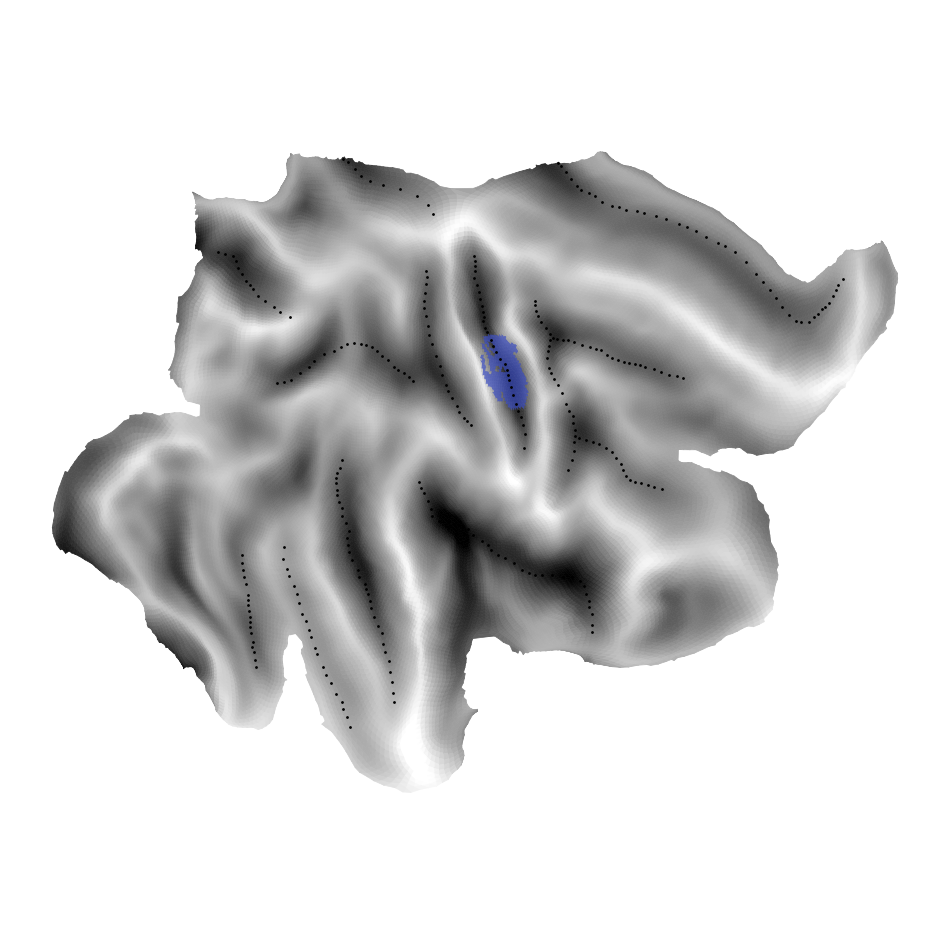

In [13]:
h = 'R'
sn = 101
vertices = [40658]

S = sl.load(os.path.join(analysisDir,'searchlight',f'sl_{h}_s{sn}.h5'))
borders = {'L': '/Users/aghavamp/Desktop/Projects/surfAnalysisPy/standard_mesh/fs_L/fs_LR.32k.L.border',
           'R': '/Users/aghavamp/Desktop/Projects/surfAnalysisPy/standard_mesh/fs_R/fs_LR.32k.R.border'}

S.center_indx
S.voxel_indx
voxlist = S.voxlist

if h == 'R':
    vertices = [v - 32492 for v in vertices]

template_nii_path = os.path.join(baseDir, 'glmsingle', f's{sn}', 'mask.nii')
mask = nb.load(template_nii_path)
sz = mask.shape
affine = mask.affine

for vert in vertices:
    center_mask = np.zeros(sz)
    searchlight = np.transpose(S.voxel_indx[:, voxlist[vert]])
    for i, j, k in searchlight:
        center_mask[i, j, k] = 1

    center_nii = nb.Nifti1Image(center_mask, affine=affine)
    nb.save(center_nii, os.path.join(baseDir, 'searchlight', f'center_s{sn}_{h}_{vert}.nii'))

# project searchlight to surf:
surf_white = os.path.join(baseDir,surfacewbDir, f's{sn}', f's{sn}.{h}.white.32k.surf.gii')
surf_pial = os.path.join(baseDir,surfacewbDir, f's{sn}', f's{sn}.{h}.pial.32k.surf.gii')
surf_sulc = os.path.join(baseDir,surfacewbDir, f's{sn}', f's{sn}.{h}.sulc.32k.shape.gii')

for vert in vertices:
    # Map a Nifti to the surface of left hemisphere
    DL = surf.map.vol_to_surf([os.path.join(baseDir, 'searchlight', f'center_s{sn}_{h}_{vert}.nii')], surf_pial, surf_white, stats='mode')

    fig, axs = plt.subplots(figsize=(12, 12))
    surf.plot.plotmap(DL, f'fs32k_{h}',
                        underlay=None,
                        borders=borders[h],
                        underscale=[-1.5, 1],
                        alpha=.7,
                        cmap='coolwarm',
                        overlay_type='label'
                        )
    plt.show()




# Contra ipsi intrinsic corr

In [2]:
sn_list = [101, 102, 103, 104, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115]
# sn_list = [104,106]
glm = 1
hem = ['L', 'R']
sl_name = ['left_cortex', 'right_cortex']

def corr_function(data, **kwargs):
    Y = data[:-1, :] / np.sqrt(data[-1,:])
    num_voxels = Y.shape[1]
    partition_vec = kwargs['partition_vec']
    condition_vec = kwargs['condition_vec']
    
    # intrinsic order:
    cond_set1 = ['lhand:0', 'lhand:60', 'lhand:120', 'lhand:180', 'lhand:240', 'lhand:300']
    cond_set2 = ['rhand:180', 'rhand:120', 'rhand:60', 'rhand:0', 'rhand:300', 'rhand:240']

    # avg patterns across partitions:
    # left hand:
    avg_patterns_left = np.zeros((6, num_voxels))
    for cnd in cond_set1:
        rows = [j for j, c in enumerate(condition_vec) if c.strip() == cnd]
        avg_patterns_left[cond_set1.index(cnd), :] = np.mean(Y[rows, :], axis=0)
    
    # remove the mean of voxels across conditions:
    avg_patterns_left = avg_patterns_left - np.mean(avg_patterns_left, axis=0)
    # vectorize:
    vec_left = avg_patterns_left.flatten()
    
    # right hand:
    avg_patterns_right = np.zeros((6, num_voxels))
    for cnd in cond_set2:
        rows = [j for j, c in enumerate(condition_vec) if c.strip() == cnd]
        avg_patterns_right[cond_set2.index(cnd), :] = np.mean(Y[rows, :], axis=0)
    # remove the mean of voxels across conditions:
    avg_patterns_right = avg_patterns_right - np.mean(avg_patterns_right, axis=0)
    # vectorize:
    vec_right = avg_patterns_right.flatten()

    # compute correlation:
    r = np.corrcoef(vec_left, vec_right)[0,1]

    return r

for sn in sn_list:
    print(f'Processing subject {sn}...')
    # regressor info:
    reginfo = pd.read_table(os.path.join(baseDir, f'glm{glm}', f's{sn}', 'reginfo.tsv'))
    # get indices of the regressors of interest:
    regressors_of_interest = reginfo[(~reginfo.name.str.contains('bi'))].index.tolist()
    
    datafiles = [os.path.join(baseDir, f'glm{glm}', f's{sn}', f'beta_{i+1:04d}.nii') for i in regressors_of_interest]
    datafiles.append(os.path.join(baseDir, f'glm{glm}', f's{sn}', 'ResMS.nii'))
    partition_vec = reginfo.loc[regressors_of_interest, 'run'].values
    condition_vec = reginfo.loc[regressors_of_interest, 'name'].values

    for i, h in enumerate(hem):
        S = sl.load(os.path.join(analysisDir,'searchlight',f'sl_{h}_s{sn}.h5'))
        results = S.run(datafiles, corr_function, {'partition_vec': partition_vec, 'condition_vec': condition_vec}, verbose=False)
        S.data_to_cifti(results, outfilename=os.path.join(baseDir, 'searchlight', f'glm{glm}_corr_intrinsic_s{sn}_{h}_cortex.dscalar.nii'))



Processing subject 101...
Processing subject 102...
Processing subject 103...
Processing subject 104...
Processing subject 106...
Processing subject 107...
Processing subject 108...
Processing subject 109...
Processing subject 110...
Processing subject 111...
Processing subject 112...
Processing subject 113...
Processing subject 114...
Processing subject 115...


# Contra ipsi extrinsic corr

In [3]:
sn_list = [101, 102, 103, 104, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115]
# sn_list = [104,106]
glm = 1
hem = ['L', 'R']
sl_name = ['left_cortex', 'right_cortex']

def corr_function(data, **kwargs):
    Y = data[:-1, :] / np.sqrt(data[-1,:])
    num_voxels = Y.shape[1]
    partition_vec = kwargs['partition_vec']
    condition_vec = kwargs['condition_vec']
    
    # extrinsic order:
    cond_set1 = ['lhand:0', 'lhand:60', 'lhand:120', 'lhand:180', 'lhand:240', 'lhand:300']
    cond_set2 = ['rhand:0', 'rhand:60', 'rhand:120', 'rhand:180', 'rhand:240', 'rhand:300']

    # avg patterns across partitions:
    # left hand:
    avg_patterns_left = np.zeros((6, num_voxels))
    for cnd in cond_set1:
        rows = [j for j, c in enumerate(condition_vec) if c.strip() == cnd]
        avg_patterns_left[cond_set1.index(cnd), :] = np.mean(Y[rows, :], axis=0)
    
    # remove the mean of voxels across conditions:
    avg_patterns_left = avg_patterns_left - np.mean(avg_patterns_left, axis=0)
    # vectorize:
    vec_left = avg_patterns_left.flatten()
    
    # right hand:
    avg_patterns_right = np.zeros((6, num_voxels))
    for cnd in cond_set2:
        rows = [j for j, c in enumerate(condition_vec) if c.strip() == cnd]
        avg_patterns_right[cond_set2.index(cnd), :] = np.mean(Y[rows, :], axis=0)
    # remove the mean of voxels across conditions:
    avg_patterns_right = avg_patterns_right - np.mean(avg_patterns_right, axis=0)
    # vectorize:
    vec_right = avg_patterns_right.flatten()

    # compute correlation:
    r = np.corrcoef(vec_left, vec_right)[0,1]

    return r

for sn in sn_list:
    print(f'Processing subject {sn}...')
    # regressor info:
    reginfo = pd.read_table(os.path.join(baseDir, f'glm{glm}', f's{sn}', 'reginfo.tsv'))
    # get indices of the regressors of interest:
    regressors_of_interest = reginfo[(~reginfo.name.str.contains('bi'))].index.tolist()
    
    datafiles = [os.path.join(baseDir, f'glm{glm}', f's{sn}', f'beta_{i+1:04d}.nii') for i in regressors_of_interest]
    datafiles.append(os.path.join(baseDir, f'glm{glm}', f's{sn}', 'ResMS.nii'))
    partition_vec = reginfo.loc[regressors_of_interest, 'run'].values
    condition_vec = reginfo.loc[regressors_of_interest, 'name'].values

    for i, h in enumerate(hem):
        S = sl.load(os.path.join(analysisDir,'searchlight',f'sl_{h}_s{sn}.h5'))
        results = S.run(datafiles, corr_function, {'partition_vec': partition_vec, 'condition_vec': condition_vec}, verbose=False)
        S.data_to_cifti(results, outfilename=os.path.join(baseDir, 'searchlight', f'glm{glm}_corr_extrinsic_s{sn}_{h}_cortex.dscalar.nii'))



Processing subject 101...


Processing subject 102...
Processing subject 103...
Processing subject 104...
Processing subject 106...
Processing subject 107...
Processing subject 108...
Processing subject 109...
Processing subject 110...
Processing subject 111...
Processing subject 112...
Processing subject 113...
Processing subject 114...
Processing subject 115...


# Variance Decompose Contra

decompose the bimanual pattern variacen into contra, ipsi, and interaction terms. The weights for each component are saved for each saerchlight location.

In [3]:
sn_list = [101, 104, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115]
sn_list = [115]
glm = 1
hem = ['L', 'R']
sl_name = ['left_cortex', 'right_cortex']

def decompose_var(data, **kwargs):
    Y_all = data[:-1,:] / np.sqrt(data[-1,:]) # univariate prewhitening
    part_vec = kwargs['partition_vec']
    cond_vec = kwargs['condition_vec']
    invX = kwargs['invX']
    
    # estimate the G matrix:
    G_hat,_ = pcm.est_G_crossval(Y_all,
                                cond_vec,
                                part_vec,
                                X=pcm.matrix.indicator(part_vec))
    # OLS Model Fit:
    W = invX @ G_hat.flatten()
    return W[0]

# Define the Models:
np.random.seed(0)
ncond = 36

# Generate the three model components, each one as a fixed model
A = np.zeros((ncond, 6))
for i in range(6):
    A[i*6:(i+1)*6, i] = 1.0
B = np.tile(np.eye(6), (6, 1))
I = np.eye(ncond)
# Orthogonalize the interaction effect
X = np.c_[A, B]
Io = I - X @ np.linalg.pinv(X) @ I

# Now Build the second moment matrix and create the full model
# for data generation:
Gc = np.zeros((3, ncond, ncond))
Gc[0] = A @ A.T
Gc[1] = B @ B.T
Gc[2] = Io @ Io.T

MC = pcm.ComponentModel('ABC', [Gc[0], Gc[1], Gc[2]])
X = np.vstack([Gc[0].flatten(), Gc[1].flatten(), Gc[2].flatten()]).T
invX = np.linalg.pinv((X.T@X)) @ X.T

for sn in sn_list:
    # try:
    # run marginal MVPA:
    # regressor info:
    reginfo = pd.read_table(os.path.join(baseDir, f'glm{glm}', f's{sn}', 'reginfo.tsv'))
    # get indices of the regressors of interest:
    regressors_of_interest = reginfo[reginfo.name.str.contains('bi')].index.tolist()
    
    datafiles = [os.path.join(baseDir, f'glm{glm}', f's{sn}', f'beta_{i+1:04d}.nii') for i in regressors_of_interest]
    datafiles.append(os.path.join(baseDir, f'glm{glm}', f's{sn}', 'ResMS.nii'))
    partition_vec = reginfo.loc[regressors_of_interest, 'run'].values
    condition_vec = reginfo.loc[regressors_of_interest, 'name'].values
    
    for i, h in enumerate(hem):
        print(f'====================== Processing subject {sn}, hemisphere {h} ======================')
        S = sl.load(os.path.join(analysisDir,'searchlight',f'sl_{h}_s{sn}.h5'))

        angles = [0, 60, 120, 180, 240, 300]
        # make the condition_vec (we wanna sort such that we get contra_0, contra_60, ... order):
        conditions = []
        if h == 'L':
                # right hand is contralateral:
                for angle_contra in angles:
                    for angle_ipsi in angles:
                        conditions.append(f'bi:{angle_ipsi}_{angle_contra}')
        if h == 'R':
                # left hand is contralateral:
                for angle_contra in angles:
                    for angle_ipsi in angles:
                        conditions.append(f'bi:{angle_contra}_{angle_ipsi}')
        
        # make cond_vec according to the sorting
        cond_vec = np.zeros_like(condition_vec, dtype=int)
        for cond in conditions:
            rows = [j for j, c in enumerate(condition_vec) if c.strip() == cond]
            cond_vec[rows] = conditions.index(cond)
        results = S.run_parallel(datafiles, decompose_var, {'partition_vec': partition_vec, 'condition_vec': cond_vec, 'hem': h, 'invX': invX})
        S.data_to_cifti(results, outfilename=os.path.join(baseDir, 'searchlight', f'glm{glm}_varContra_s{sn}_{h}_cortex.dscalar.nii'))

    # except:
    #         print(f'Error processing subject {sn}. Skipping...')
    #         continue



====================== Processing subject 115, hemisphere L ======================
Loading 361 volumes...
Running searchlight on 32492 centers...


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 14 concurrent workers.
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done  22 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 428 tasks      | elapsed:    3.5s
[Parallel(n_jobs=-1)]: Done 1328 tasks      | elapsed:    5.1s
[Parallel(n_jobs=-1)]: Done 2228 tasks      | elapsed:    6.6s
[Parallel(n_jobs=-1)]: Done 3328 tasks      | elapsed:    8.4s
[Parallel(n_jobs=-1)]: Done 4428 tasks      | elapsed:   10.3s
[Parallel(n_jobs=-1)]: Done 5728 tasks      | elapsed:   12.5s
[Parallel(n_jobs=-1)]: Done 7028 tasks      | elapsed:   14.7s
[Parallel(n_jobs=-1)]: Done 8528 tasks      | elapsed:   17.2s
[Parallel(n_jobs=-1)]: Done 10028 tasks      | elapsed:   19.7s
[Parallel(n_jobs=-1)]: Done 11728 tasks      | elapsed:   21.9s
[Parallel(n_jobs=-1)]: Done 13428 tasks      | elapsed:   25.3s
[Parallel(n_jobs=-1)]: Done 15328 tasks      | elapsed:   28.6s
[Parallel(n_jobs=-1)]: Done 17228 tasks 

====================== Processing subject 115, hemisphere R ======================
Loading 361 volumes...
Running searchlight on 32492 centers...


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 14 concurrent workers.
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done  22 tasks      | elapsed:    1.9s
[Parallel(n_jobs=-1)]: Done 428 tasks      | elapsed:    3.7s
[Parallel(n_jobs=-1)]: Done 1328 tasks      | elapsed:    5.2s
[Parallel(n_jobs=-1)]: Done 2228 tasks      | elapsed:    6.8s
[Parallel(n_jobs=-1)]: Done 3328 tasks      | elapsed:    8.7s
[Parallel(n_jobs=-1)]: Done 4428 tasks      | elapsed:   10.6s
[Parallel(n_jobs=-1)]: Done 5728 tasks      | elapsed:   12.8s
[Parallel(n_jobs=-1)]: Done 7028 tasks      | elapsed:   15.0s
[Parallel(n_jobs=-1)]: Done 8528 tasks      | elapsed:   17.6s
[Parallel(n_jobs=-1)]: Done 10028 tasks      | elapsed:   20.2s
[Parallel(n_jobs=-1)]: Done 11728 tasks      | elapsed:   22.5s
[Parallel(n_jobs=-1)]: Done 13428 tasks      | elapsed:   26.1s
[Parallel(n_jobs=-1)]: Done 15328 tasks      | elapsed:   29.3s
[Parallel(n_jobs=-1)]: Done 17228 tasks 

# Var Decompose Ipsi

In [4]:
sn_list = [101, 104, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115]
glm = 1
hem = ['L', 'R']
sl_name = ['left_cortex', 'right_cortex']

def decompose_var(data, **kwargs):
    Y_all = data[:-1,:] / np.sqrt(data[-1,:]) # univariate prewhitening
    part_vec = kwargs['partition_vec']
    cond_vec = kwargs['condition_vec']
    invX = kwargs['invX']
    
    # estimate the G matrix:
    G_hat,_ = pcm.est_G_crossval(Y_all,
                                cond_vec,
                                part_vec,
                                X=pcm.matrix.indicator(part_vec))
    # OLS Model Fit:
    W = invX @ G_hat.flatten()
    return W[1]

# Define the Models:
np.random.seed(0)
ncond = 36

# Generate the three model components, each one as a fixed model
A = np.zeros((ncond, 6))
for i in range(6):
    A[i*6:(i+1)*6, i] = 1.0
B = np.tile(np.eye(6), (6, 1))
I = np.eye(ncond)
# Orthogonalize the interaction effect
X = np.c_[A, B]
Io = I - X @ np.linalg.pinv(X) @ I

# Now Build the second moment matrix and create the full model
# for data generation:
Gc = np.zeros((3, ncond, ncond))
Gc[0] = A @ A.T
Gc[1] = B @ B.T
Gc[2] = Io @ Io.T

MC = pcm.ComponentModel('ABC', [Gc[0], Gc[1], Gc[2]])
X = np.vstack([Gc[0].flatten(), Gc[1].flatten(), Gc[2].flatten()]).T
invX = np.linalg.pinv((X.T@X)) @ X.T

for sn in sn_list:
    # try:
    # run marginal MVPA:
    # regressor info:
    reginfo = pd.read_table(os.path.join(baseDir, f'glm{glm}', f's{sn}', 'reginfo.tsv'))
    # get indices of the regressors of interest:
    regressors_of_interest = reginfo[reginfo.name.str.contains('bi')].index.tolist()
    
    datafiles = [os.path.join(baseDir, f'glm{glm}', f's{sn}', f'beta_{i+1:04d}.nii') for i in regressors_of_interest]
    datafiles.append(os.path.join(baseDir, f'glm{glm}', f's{sn}', 'ResMS.nii'))
    partition_vec = reginfo.loc[regressors_of_interest, 'run'].values
    condition_vec = reginfo.loc[regressors_of_interest, 'name'].values
    
    for i, h in enumerate(hem):
        print(f'====================== Processing subject {sn}, hemisphere {h} ======================')
        S = sl.load(os.path.join(analysisDir,'searchlight',f'sl_{h}_s{sn}.h5'))

        angles = [0, 60, 120, 180, 240, 300]
        # make the condition_vec (we wanna sort such that we get contra_0, contra_60, ... order):
        conditions = []
        if h == 'L':
                # right hand is contralateral:
                for angle_contra in angles:
                    for angle_ipsi in angles:
                        conditions.append(f'bi:{angle_ipsi}_{angle_contra}')
        if h == 'R':
                # left hand is contralateral:
                for angle_contra in angles:
                    for angle_ipsi in angles:
                        conditions.append(f'bi:{angle_contra}_{angle_ipsi}')

        # make cond_vec according to the sorting
        cond_vec = np.zeros_like(condition_vec, dtype=int)
        for cond in conditions:
            rows = [j for j, c in enumerate(condition_vec) if c.strip() == cond]
            cond_vec[rows] = conditions.index(cond)
        results = S.run_parallel(datafiles, decompose_var, {'partition_vec': partition_vec, 'condition_vec': cond_vec, 'hem': h, 'invX': invX})
        S.data_to_cifti(results, outfilename=os.path.join(baseDir, 'searchlight', f'glm{glm}_varIpsi_s{sn}_{h}_cortex.dscalar.nii'))



====================== Processing subject 101, hemisphere L ======================
Loading 361 volumes...
Running searchlight on 32492 centers...


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 14 concurrent workers.
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done  22 tasks      | elapsed:    1.9s
[Parallel(n_jobs=-1)]: Done 428 tasks      | elapsed:    3.6s
[Parallel(n_jobs=-1)]: Done 1328 tasks      | elapsed:    5.3s
[Parallel(n_jobs=-1)]: Done 2228 tasks      | elapsed:    6.8s
[Parallel(n_jobs=-1)]: Done 3328 tasks      | elapsed:    8.6s
[Parallel(n_jobs=-1)]: Done 4428 tasks      | elapsed:   10.5s
[Parallel(n_jobs=-1)]: Done 5728 tasks      | elapsed:   12.7s
[Parallel(n_jobs=-1)]: Done 7028 tasks      | elapsed:   14.9s
[Parallel(n_jobs=-1)]: Done 8528 tasks      | elapsed:   17.4s
[Parallel(n_jobs=-1)]: Done 10028 tasks      | elapsed:   20.1s
[Parallel(n_jobs=-1)]: Done 11728 tasks      | elapsed:   22.6s
[Parallel(n_jobs=-1)]: Done 13428 tasks      | elapsed:   26.1s
[Parallel(n_jobs=-1)]: Done 15328 tasks      | elapsed:   29.4s
[Parallel(n_jobs=-1)]: Done 17228 tasks 

====================== Processing subject 101, hemisphere R ======================
Loading 361 volumes...
Running searchlight on 32492 centers...


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 14 concurrent workers.
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done  22 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 428 tasks      | elapsed:    3.4s
[Parallel(n_jobs=-1)]: Done 1328 tasks      | elapsed:    5.0s
[Parallel(n_jobs=-1)]: Done 2228 tasks      | elapsed:    6.5s
[Parallel(n_jobs=-1)]: Done 3328 tasks      | elapsed:    8.1s
[Parallel(n_jobs=-1)]: Done 4428 tasks      | elapsed:   10.1s
[Parallel(n_jobs=-1)]: Done 5728 tasks      | elapsed:   12.2s
[Parallel(n_jobs=-1)]: Done 7028 tasks      | elapsed:   14.4s
[Parallel(n_jobs=-1)]: Done 8528 tasks      | elapsed:   16.8s
[Parallel(n_jobs=-1)]: Done 10028 tasks      | elapsed:   19.2s
[Parallel(n_jobs=-1)]: Done 11728 tasks      | elapsed:   21.4s
[Parallel(n_jobs=-1)]: Done 13428 tasks      | elapsed:   24.7s
[Parallel(n_jobs=-1)]: Done 15328 tasks      | elapsed:   27.8s
[Parallel(n_jobs=-1)]: Done 17228 tasks 

====================== Processing subject 104, hemisphere L ======================
Loading 361 volumes...
Running searchlight on 32492 centers...


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 14 concurrent workers.
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done  22 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 428 tasks      | elapsed:    3.4s
[Parallel(n_jobs=-1)]: Done 1328 tasks      | elapsed:    4.9s
[Parallel(n_jobs=-1)]: Done 2228 tasks      | elapsed:    6.4s
[Parallel(n_jobs=-1)]: Done 3328 tasks      | elapsed:    7.9s
[Parallel(n_jobs=-1)]: Done 4428 tasks      | elapsed:   10.0s
[Parallel(n_jobs=-1)]: Done 5728 tasks      | elapsed:   12.1s
[Parallel(n_jobs=-1)]: Done 7028 tasks      | elapsed:   14.3s
[Parallel(n_jobs=-1)]: Done 8528 tasks      | elapsed:   16.6s
[Parallel(n_jobs=-1)]: Done 10028 tasks      | elapsed:   19.0s
[Parallel(n_jobs=-1)]: Done 11728 tasks      | elapsed:   21.3s
[Parallel(n_jobs=-1)]: Done 13428 tasks      | elapsed:   24.6s
[Parallel(n_jobs=-1)]: Done 15328 tasks      | elapsed:   27.7s
[Parallel(n_jobs=-1)]: Done 17228 tasks 

====================== Processing subject 104, hemisphere R ======================
Loading 361 volumes...
Running searchlight on 32492 centers...


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 14 concurrent workers.
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done  22 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 428 tasks      | elapsed:    3.3s
[Parallel(n_jobs=-1)]: Done 1328 tasks      | elapsed:    4.9s
[Parallel(n_jobs=-1)]: Done 2228 tasks      | elapsed:    6.3s
[Parallel(n_jobs=-1)]: Done 3328 tasks      | elapsed:    7.7s
[Parallel(n_jobs=-1)]: Done 4428 tasks      | elapsed:    9.9s
[Parallel(n_jobs=-1)]: Done 5728 tasks      | elapsed:   12.0s
[Parallel(n_jobs=-1)]: Done 7028 tasks      | elapsed:   14.1s
[Parallel(n_jobs=-1)]: Done 8528 tasks      | elapsed:   16.5s
[Parallel(n_jobs=-1)]: Done 10028 tasks      | elapsed:   18.9s
[Parallel(n_jobs=-1)]: Done 11728 tasks      | elapsed:   21.1s
[Parallel(n_jobs=-1)]: Done 13428 tasks      | elapsed:   24.4s
[Parallel(n_jobs=-1)]: Done 15328 tasks      | elapsed:   27.5s
[Parallel(n_jobs=-1)]: Done 17228 tasks 

====================== Processing subject 106, hemisphere L ======================
Loading 361 volumes...
Running searchlight on 32492 centers...


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 14 concurrent workers.
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done  22 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 428 tasks      | elapsed:    3.4s
[Parallel(n_jobs=-1)]: Done 1328 tasks      | elapsed:    4.9s
[Parallel(n_jobs=-1)]: Done 2228 tasks      | elapsed:    6.5s
[Parallel(n_jobs=-1)]: Done 3328 tasks      | elapsed:    8.2s
[Parallel(n_jobs=-1)]: Done 4428 tasks      | elapsed:   10.2s
[Parallel(n_jobs=-1)]: Done 5728 tasks      | elapsed:   12.4s
[Parallel(n_jobs=-1)]: Done 7028 tasks      | elapsed:   14.6s
[Parallel(n_jobs=-1)]: Done 8528 tasks      | elapsed:   17.2s
[Parallel(n_jobs=-1)]: Done 10028 tasks      | elapsed:   19.8s
[Parallel(n_jobs=-1)]: Done 11728 tasks      | elapsed:   22.1s
[Parallel(n_jobs=-1)]: Done 13428 tasks      | elapsed:   25.4s
[Parallel(n_jobs=-1)]: Done 15328 tasks      | elapsed:   28.6s
[Parallel(n_jobs=-1)]: Done 17228 tasks 

====================== Processing subject 106, hemisphere R ======================
Loading 361 volumes...
Running searchlight on 32492 centers...


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 14 concurrent workers.
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done  22 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 428 tasks      | elapsed:    3.4s
[Parallel(n_jobs=-1)]: Done 1328 tasks      | elapsed:    4.9s
[Parallel(n_jobs=-1)]: Done 2228 tasks      | elapsed:    6.4s
[Parallel(n_jobs=-1)]: Done 3328 tasks      | elapsed:    8.2s
[Parallel(n_jobs=-1)]: Done 4428 tasks      | elapsed:   10.1s
[Parallel(n_jobs=-1)]: Done 5728 tasks      | elapsed:   12.2s
[Parallel(n_jobs=-1)]: Done 7028 tasks      | elapsed:   14.4s
[Parallel(n_jobs=-1)]: Done 8528 tasks      | elapsed:   17.0s
[Parallel(n_jobs=-1)]: Done 10028 tasks      | elapsed:   19.4s
[Parallel(n_jobs=-1)]: Done 11728 tasks      | elapsed:   21.9s
[Parallel(n_jobs=-1)]: Done 13428 tasks      | elapsed:   25.1s
[Parallel(n_jobs=-1)]: Done 15328 tasks      | elapsed:   28.4s
[Parallel(n_jobs=-1)]: Done 17228 tasks 

====================== Processing subject 107, hemisphere L ======================
Loading 361 volumes...
Running searchlight on 32492 centers...


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 14 concurrent workers.
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done  22 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 428 tasks      | elapsed:    3.2s
[Parallel(n_jobs=-1)]: Done 1328 tasks      | elapsed:    4.8s
[Parallel(n_jobs=-1)]: Done 2228 tasks      | elapsed:    6.2s
[Parallel(n_jobs=-1)]: Done 3328 tasks      | elapsed:    7.7s
[Parallel(n_jobs=-1)]: Done 4428 tasks      | elapsed:    9.8s
[Parallel(n_jobs=-1)]: Done 5728 tasks      | elapsed:   11.9s
[Parallel(n_jobs=-1)]: Done 7028 tasks      | elapsed:   14.0s
[Parallel(n_jobs=-1)]: Done 8528 tasks      | elapsed:   16.3s
[Parallel(n_jobs=-1)]: Done 10028 tasks      | elapsed:   18.7s
[Parallel(n_jobs=-1)]: Done 11728 tasks      | elapsed:   20.9s
[Parallel(n_jobs=-1)]: Done 13428 tasks      | elapsed:   24.2s
[Parallel(n_jobs=-1)]: Done 15328 tasks      | elapsed:   27.3s
[Parallel(n_jobs=-1)]: Done 17228 tasks 

====================== Processing subject 107, hemisphere R ======================
Loading 361 volumes...
Running searchlight on 32492 centers...


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 14 concurrent workers.
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done  22 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 428 tasks      | elapsed:    3.2s
[Parallel(n_jobs=-1)]: Done 1328 tasks      | elapsed:    4.7s
[Parallel(n_jobs=-1)]: Done 2228 tasks      | elapsed:    6.3s
[Parallel(n_jobs=-1)]: Done 3328 tasks      | elapsed:    7.6s
[Parallel(n_jobs=-1)]: Done 4428 tasks      | elapsed:    9.7s
[Parallel(n_jobs=-1)]: Done 5728 tasks      | elapsed:   11.9s
[Parallel(n_jobs=-1)]: Done 7028 tasks      | elapsed:   14.0s
[Parallel(n_jobs=-1)]: Done 8528 tasks      | elapsed:   16.4s
[Parallel(n_jobs=-1)]: Done 10028 tasks      | elapsed:   18.8s
[Parallel(n_jobs=-1)]: Done 11728 tasks      | elapsed:   21.0s
[Parallel(n_jobs=-1)]: Done 13428 tasks      | elapsed:   24.3s
[Parallel(n_jobs=-1)]: Done 15328 tasks      | elapsed:   27.4s
[Parallel(n_jobs=-1)]: Done 17228 tasks 

====================== Processing subject 108, hemisphere L ======================
Loading 361 volumes...
Running searchlight on 32492 centers...


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 14 concurrent workers.
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done  22 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 428 tasks      | elapsed:    3.3s
[Parallel(n_jobs=-1)]: Done 1328 tasks      | elapsed:    4.8s
[Parallel(n_jobs=-1)]: Done 2228 tasks      | elapsed:    6.3s
[Parallel(n_jobs=-1)]: Done 3328 tasks      | elapsed:    7.8s
[Parallel(n_jobs=-1)]: Done 4428 tasks      | elapsed:    9.8s
[Parallel(n_jobs=-1)]: Done 5728 tasks      | elapsed:   12.0s
[Parallel(n_jobs=-1)]: Done 7028 tasks      | elapsed:   14.1s
[Parallel(n_jobs=-1)]: Done 8528 tasks      | elapsed:   16.5s
[Parallel(n_jobs=-1)]: Done 10028 tasks      | elapsed:   18.9s
[Parallel(n_jobs=-1)]: Done 11728 tasks      | elapsed:   21.1s
[Parallel(n_jobs=-1)]: Done 13428 tasks      | elapsed:   24.4s
[Parallel(n_jobs=-1)]: Done 15328 tasks      | elapsed:   27.5s
[Parallel(n_jobs=-1)]: Done 17228 tasks 

====================== Processing subject 108, hemisphere R ======================
Loading 361 volumes...
Running searchlight on 32492 centers...


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 14 concurrent workers.
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done  22 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 428 tasks      | elapsed:    3.2s
[Parallel(n_jobs=-1)]: Done 1328 tasks      | elapsed:    4.7s
[Parallel(n_jobs=-1)]: Done 2228 tasks      | elapsed:    6.3s
[Parallel(n_jobs=-1)]: Done 3328 tasks      | elapsed:    7.7s
[Parallel(n_jobs=-1)]: Done 4428 tasks      | elapsed:    9.8s
[Parallel(n_jobs=-1)]: Done 5728 tasks      | elapsed:   11.9s
[Parallel(n_jobs=-1)]: Done 7028 tasks      | elapsed:   14.0s
[Parallel(n_jobs=-1)]: Done 8528 tasks      | elapsed:   16.5s
[Parallel(n_jobs=-1)]: Done 10028 tasks      | elapsed:   18.7s
[Parallel(n_jobs=-1)]: Done 11728 tasks      | elapsed:   21.0s
[Parallel(n_jobs=-1)]: Done 13428 tasks      | elapsed:   24.3s
[Parallel(n_jobs=-1)]: Done 15328 tasks      | elapsed:   27.3s
[Parallel(n_jobs=-1)]: Done 17228 tasks 

====================== Processing subject 109, hemisphere L ======================
Loading 361 volumes...
Running searchlight on 32492 centers...


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 14 concurrent workers.
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done  22 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 428 tasks      | elapsed:    3.4s
[Parallel(n_jobs=-1)]: Done 1328 tasks      | elapsed:    4.9s
[Parallel(n_jobs=-1)]: Done 2228 tasks      | elapsed:    6.4s
[Parallel(n_jobs=-1)]: Done 3328 tasks      | elapsed:    8.3s
[Parallel(n_jobs=-1)]: Done 4428 tasks      | elapsed:   10.1s
[Parallel(n_jobs=-1)]: Done 5728 tasks      | elapsed:   12.3s
[Parallel(n_jobs=-1)]: Done 7028 tasks      | elapsed:   14.5s
[Parallel(n_jobs=-1)]: Done 8528 tasks      | elapsed:   17.0s
[Parallel(n_jobs=-1)]: Done 10028 tasks      | elapsed:   19.6s
[Parallel(n_jobs=-1)]: Done 11728 tasks      | elapsed:   21.9s
[Parallel(n_jobs=-1)]: Done 13428 tasks      | elapsed:   25.2s
[Parallel(n_jobs=-1)]: Done 15328 tasks      | elapsed:   28.4s
[Parallel(n_jobs=-1)]: Done 17228 tasks 

====================== Processing subject 109, hemisphere R ======================
Loading 361 volumes...
Running searchlight on 32492 centers...


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 14 concurrent workers.
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done  22 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 428 tasks      | elapsed:    3.4s
[Parallel(n_jobs=-1)]: Done 1328 tasks      | elapsed:    4.9s
[Parallel(n_jobs=-1)]: Done 2228 tasks      | elapsed:    6.4s
[Parallel(n_jobs=-1)]: Done 3328 tasks      | elapsed:    8.2s
[Parallel(n_jobs=-1)]: Done 4428 tasks      | elapsed:   10.1s
[Parallel(n_jobs=-1)]: Done 5728 tasks      | elapsed:   12.2s
[Parallel(n_jobs=-1)]: Done 7028 tasks      | elapsed:   14.4s
[Parallel(n_jobs=-1)]: Done 8528 tasks      | elapsed:   16.9s
[Parallel(n_jobs=-1)]: Done 10028 tasks      | elapsed:   19.3s
[Parallel(n_jobs=-1)]: Done 11728 tasks      | elapsed:   21.6s
[Parallel(n_jobs=-1)]: Done 13428 tasks      | elapsed:   24.9s
[Parallel(n_jobs=-1)]: Done 15328 tasks      | elapsed:   28.1s
[Parallel(n_jobs=-1)]: Done 17228 tasks 

====================== Processing subject 110, hemisphere L ======================
Loading 361 volumes...
Running searchlight on 32492 centers...


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 14 concurrent workers.
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done  22 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 428 tasks      | elapsed:    3.4s
[Parallel(n_jobs=-1)]: Done 1328 tasks      | elapsed:    4.9s
[Parallel(n_jobs=-1)]: Done 2228 tasks      | elapsed:    6.4s
[Parallel(n_jobs=-1)]: Done 3328 tasks      | elapsed:    8.3s
[Parallel(n_jobs=-1)]: Done 4428 tasks      | elapsed:   10.1s
[Parallel(n_jobs=-1)]: Done 5728 tasks      | elapsed:   12.3s
[Parallel(n_jobs=-1)]: Done 7028 tasks      | elapsed:   14.5s
[Parallel(n_jobs=-1)]: Done 8528 tasks      | elapsed:   17.0s
[Parallel(n_jobs=-1)]: Done 10028 tasks      | elapsed:   19.6s
[Parallel(n_jobs=-1)]: Done 11728 tasks      | elapsed:   22.1s
[Parallel(n_jobs=-1)]: Done 13428 tasks      | elapsed:   25.3s
[Parallel(n_jobs=-1)]: Done 15328 tasks      | elapsed:   28.5s
[Parallel(n_jobs=-1)]: Done 17228 tasks 

====================== Processing subject 110, hemisphere R ======================
Loading 361 volumes...
Running searchlight on 32492 centers...


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 14 concurrent workers.
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done  22 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 428 tasks      | elapsed:    3.4s
[Parallel(n_jobs=-1)]: Done 1328 tasks      | elapsed:    4.9s
[Parallel(n_jobs=-1)]: Done 2228 tasks      | elapsed:    6.4s
[Parallel(n_jobs=-1)]: Done 3328 tasks      | elapsed:    8.2s
[Parallel(n_jobs=-1)]: Done 4428 tasks      | elapsed:   10.0s
[Parallel(n_jobs=-1)]: Done 5728 tasks      | elapsed:   12.1s
[Parallel(n_jobs=-1)]: Done 7028 tasks      | elapsed:   14.3s
[Parallel(n_jobs=-1)]: Done 8528 tasks      | elapsed:   16.9s
[Parallel(n_jobs=-1)]: Done 10028 tasks      | elapsed:   19.3s
[Parallel(n_jobs=-1)]: Done 11728 tasks      | elapsed:   21.6s
[Parallel(n_jobs=-1)]: Done 13428 tasks      | elapsed:   24.9s
[Parallel(n_jobs=-1)]: Done 15328 tasks      | elapsed:   28.1s
[Parallel(n_jobs=-1)]: Done 17228 tasks 

====================== Processing subject 111, hemisphere L ======================
Loading 361 volumes...
Running searchlight on 32492 centers...


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 14 concurrent workers.
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done  22 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 428 tasks      | elapsed:    3.4s
[Parallel(n_jobs=-1)]: Done 1328 tasks      | elapsed:    4.9s
[Parallel(n_jobs=-1)]: Done 2228 tasks      | elapsed:    6.4s
[Parallel(n_jobs=-1)]: Done 3328 tasks      | elapsed:    8.1s
[Parallel(n_jobs=-1)]: Done 4428 tasks      | elapsed:   10.0s
[Parallel(n_jobs=-1)]: Done 5728 tasks      | elapsed:   12.2s
[Parallel(n_jobs=-1)]: Done 7028 tasks      | elapsed:   14.4s
[Parallel(n_jobs=-1)]: Done 8528 tasks      | elapsed:   16.9s
[Parallel(n_jobs=-1)]: Done 10028 tasks      | elapsed:   19.4s
[Parallel(n_jobs=-1)]: Done 11728 tasks      | elapsed:   21.6s
[Parallel(n_jobs=-1)]: Done 13428 tasks      | elapsed:   24.9s
[Parallel(n_jobs=-1)]: Done 15328 tasks      | elapsed:   28.1s
[Parallel(n_jobs=-1)]: Done 17228 tasks 

====================== Processing subject 111, hemisphere R ======================
Loading 361 volumes...
Running searchlight on 32492 centers...


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 14 concurrent workers.
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done  22 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 428 tasks      | elapsed:    3.4s
[Parallel(n_jobs=-1)]: Done 1328 tasks      | elapsed:    4.9s
[Parallel(n_jobs=-1)]: Done 2228 tasks      | elapsed:    6.4s
[Parallel(n_jobs=-1)]: Done 3328 tasks      | elapsed:    8.1s
[Parallel(n_jobs=-1)]: Done 4428 tasks      | elapsed:   10.1s
[Parallel(n_jobs=-1)]: Done 5728 tasks      | elapsed:   12.2s
[Parallel(n_jobs=-1)]: Done 7028 tasks      | elapsed:   14.3s
[Parallel(n_jobs=-1)]: Done 8528 tasks      | elapsed:   16.8s
[Parallel(n_jobs=-1)]: Done 10028 tasks      | elapsed:   19.3s
[Parallel(n_jobs=-1)]: Done 11728 tasks      | elapsed:   21.6s
[Parallel(n_jobs=-1)]: Done 13428 tasks      | elapsed:   24.9s
[Parallel(n_jobs=-1)]: Done 15328 tasks      | elapsed:   28.1s
[Parallel(n_jobs=-1)]: Done 17228 tasks 

====================== Processing subject 112, hemisphere L ======================
Loading 361 volumes...
Running searchlight on 32492 centers...


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 14 concurrent workers.
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done  22 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 428 tasks      | elapsed:    3.4s
[Parallel(n_jobs=-1)]: Done 1328 tasks      | elapsed:    5.0s
[Parallel(n_jobs=-1)]: Done 2228 tasks      | elapsed:    6.5s
[Parallel(n_jobs=-1)]: Done 3328 tasks      | elapsed:    8.3s
[Parallel(n_jobs=-1)]: Done 4428 tasks      | elapsed:   10.2s
[Parallel(n_jobs=-1)]: Done 5728 tasks      | elapsed:   12.3s
[Parallel(n_jobs=-1)]: Done 7028 tasks      | elapsed:   14.5s
[Parallel(n_jobs=-1)]: Done 8528 tasks      | elapsed:   17.0s
[Parallel(n_jobs=-1)]: Done 10028 tasks      | elapsed:   19.5s
[Parallel(n_jobs=-1)]: Done 11728 tasks      | elapsed:   21.8s
[Parallel(n_jobs=-1)]: Done 13428 tasks      | elapsed:   25.2s
[Parallel(n_jobs=-1)]: Done 15328 tasks      | elapsed:   28.4s
[Parallel(n_jobs=-1)]: Done 17228 tasks 

====================== Processing subject 112, hemisphere R ======================
Loading 361 volumes...
Running searchlight on 32492 centers...


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 14 concurrent workers.
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done  22 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 428 tasks      | elapsed:    3.4s
[Parallel(n_jobs=-1)]: Done 1328 tasks      | elapsed:    4.9s
[Parallel(n_jobs=-1)]: Done 2228 tasks      | elapsed:    6.4s
[Parallel(n_jobs=-1)]: Done 3328 tasks      | elapsed:    8.2s
[Parallel(n_jobs=-1)]: Done 4428 tasks      | elapsed:   10.0s
[Parallel(n_jobs=-1)]: Done 5728 tasks      | elapsed:   12.2s
[Parallel(n_jobs=-1)]: Done 7028 tasks      | elapsed:   14.3s
[Parallel(n_jobs=-1)]: Done 8528 tasks      | elapsed:   16.8s
[Parallel(n_jobs=-1)]: Done 10028 tasks      | elapsed:   19.3s
[Parallel(n_jobs=-1)]: Done 11728 tasks      | elapsed:   21.6s
[Parallel(n_jobs=-1)]: Done 13428 tasks      | elapsed:   24.9s
[Parallel(n_jobs=-1)]: Done 15328 tasks      | elapsed:   28.1s
[Parallel(n_jobs=-1)]: Done 17228 tasks 

====================== Processing subject 113, hemisphere L ======================
Loading 361 volumes...
Running searchlight on 32492 centers...


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 14 concurrent workers.
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done  22 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 428 tasks      | elapsed:    3.4s
[Parallel(n_jobs=-1)]: Done 1328 tasks      | elapsed:    4.9s
[Parallel(n_jobs=-1)]: Done 2228 tasks      | elapsed:    6.5s
[Parallel(n_jobs=-1)]: Done 3328 tasks      | elapsed:    8.3s
[Parallel(n_jobs=-1)]: Done 4428 tasks      | elapsed:   10.1s
[Parallel(n_jobs=-1)]: Done 5728 tasks      | elapsed:   12.3s
[Parallel(n_jobs=-1)]: Done 7028 tasks      | elapsed:   14.5s
[Parallel(n_jobs=-1)]: Done 8528 tasks      | elapsed:   17.1s
[Parallel(n_jobs=-1)]: Done 10028 tasks      | elapsed:   19.6s
[Parallel(n_jobs=-1)]: Done 11728 tasks      | elapsed:   22.4s
[Parallel(n_jobs=-1)]: Done 13428 tasks      | elapsed:   25.3s
[Parallel(n_jobs=-1)]: Done 15328 tasks      | elapsed:   28.4s
[Parallel(n_jobs=-1)]: Done 17228 tasks 

====================== Processing subject 113, hemisphere R ======================
Loading 361 volumes...
Running searchlight on 32492 centers...


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 14 concurrent workers.
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done  22 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 428 tasks      | elapsed:    3.4s
[Parallel(n_jobs=-1)]: Done 1328 tasks      | elapsed:    4.9s
[Parallel(n_jobs=-1)]: Done 2228 tasks      | elapsed:    6.4s
[Parallel(n_jobs=-1)]: Done 3328 tasks      | elapsed:    8.3s
[Parallel(n_jobs=-1)]: Done 4428 tasks      | elapsed:   10.2s
[Parallel(n_jobs=-1)]: Done 5728 tasks      | elapsed:   12.4s
[Parallel(n_jobs=-1)]: Done 7028 tasks      | elapsed:   14.6s
[Parallel(n_jobs=-1)]: Done 8528 tasks      | elapsed:   17.1s
[Parallel(n_jobs=-1)]: Done 10028 tasks      | elapsed:   19.7s
[Parallel(n_jobs=-1)]: Done 11728 tasks      | elapsed:   22.3s
[Parallel(n_jobs=-1)]: Done 13428 tasks      | elapsed:   25.4s
[Parallel(n_jobs=-1)]: Done 15328 tasks      | elapsed:   28.6s
[Parallel(n_jobs=-1)]: Done 17228 tasks 

====================== Processing subject 114, hemisphere L ======================
Loading 361 volumes...
Running searchlight on 32492 centers...


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 14 concurrent workers.
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done  22 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 428 tasks      | elapsed:    3.4s
[Parallel(n_jobs=-1)]: Done 1328 tasks      | elapsed:    4.9s
[Parallel(n_jobs=-1)]: Done 2228 tasks      | elapsed:    6.4s
[Parallel(n_jobs=-1)]: Done 3328 tasks      | elapsed:    8.2s
[Parallel(n_jobs=-1)]: Done 4428 tasks      | elapsed:   10.1s
[Parallel(n_jobs=-1)]: Done 5728 tasks      | elapsed:   12.3s
[Parallel(n_jobs=-1)]: Done 7028 tasks      | elapsed:   14.4s
[Parallel(n_jobs=-1)]: Done 8528 tasks      | elapsed:   16.9s
[Parallel(n_jobs=-1)]: Done 10028 tasks      | elapsed:   19.4s
[Parallel(n_jobs=-1)]: Done 11728 tasks      | elapsed:   21.7s
[Parallel(n_jobs=-1)]: Done 13428 tasks      | elapsed:   25.0s
[Parallel(n_jobs=-1)]: Done 15328 tasks      | elapsed:   28.2s
[Parallel(n_jobs=-1)]: Done 17228 tasks 

====================== Processing subject 114, hemisphere R ======================
Loading 361 volumes...
Running searchlight on 32492 centers...


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 14 concurrent workers.
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done  22 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 428 tasks      | elapsed:    3.4s
[Parallel(n_jobs=-1)]: Done 1328 tasks      | elapsed:    4.9s
[Parallel(n_jobs=-1)]: Done 2228 tasks      | elapsed:    6.4s
[Parallel(n_jobs=-1)]: Done 3328 tasks      | elapsed:    8.2s
[Parallel(n_jobs=-1)]: Done 4428 tasks      | elapsed:   10.0s
[Parallel(n_jobs=-1)]: Done 5728 tasks      | elapsed:   12.2s
[Parallel(n_jobs=-1)]: Done 7028 tasks      | elapsed:   14.3s
[Parallel(n_jobs=-1)]: Done 8528 tasks      | elapsed:   16.9s
[Parallel(n_jobs=-1)]: Done 10028 tasks      | elapsed:   19.4s
[Parallel(n_jobs=-1)]: Done 11728 tasks      | elapsed:   21.7s
[Parallel(n_jobs=-1)]: Done 13428 tasks      | elapsed:   25.0s
[Parallel(n_jobs=-1)]: Done 15328 tasks      | elapsed:   28.2s
[Parallel(n_jobs=-1)]: Done 17228 tasks 

====================== Processing subject 115, hemisphere L ======================
Loading 361 volumes...
Running searchlight on 32492 centers...


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 14 concurrent workers.
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done  22 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 428 tasks      | elapsed:    3.4s
[Parallel(n_jobs=-1)]: Done 1328 tasks      | elapsed:    4.9s
[Parallel(n_jobs=-1)]: Done 2228 tasks      | elapsed:    6.5s
[Parallel(n_jobs=-1)]: Done 3328 tasks      | elapsed:    8.3s
[Parallel(n_jobs=-1)]: Done 4428 tasks      | elapsed:   10.1s
[Parallel(n_jobs=-1)]: Done 5728 tasks      | elapsed:   12.3s
[Parallel(n_jobs=-1)]: Done 7028 tasks      | elapsed:   14.5s
[Parallel(n_jobs=-1)]: Done 8528 tasks      | elapsed:   17.1s
[Parallel(n_jobs=-1)]: Done 10028 tasks      | elapsed:   19.6s
[Parallel(n_jobs=-1)]: Done 11728 tasks      | elapsed:   21.9s
[Parallel(n_jobs=-1)]: Done 13428 tasks      | elapsed:   25.2s
[Parallel(n_jobs=-1)]: Done 15328 tasks      | elapsed:   28.4s
[Parallel(n_jobs=-1)]: Done 17228 tasks 

====================== Processing subject 115, hemisphere R ======================
Loading 361 volumes...
Running searchlight on 32492 centers...


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 14 concurrent workers.
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done  22 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 428 tasks      | elapsed:    3.4s
[Parallel(n_jobs=-1)]: Done 1328 tasks      | elapsed:    4.9s
[Parallel(n_jobs=-1)]: Done 2228 tasks      | elapsed:    6.5s
[Parallel(n_jobs=-1)]: Done 3328 tasks      | elapsed:    8.3s
[Parallel(n_jobs=-1)]: Done 4428 tasks      | elapsed:   10.2s
[Parallel(n_jobs=-1)]: Done 5728 tasks      | elapsed:   12.3s
[Parallel(n_jobs=-1)]: Done 7028 tasks      | elapsed:   14.6s
[Parallel(n_jobs=-1)]: Done 8528 tasks      | elapsed:   17.1s
[Parallel(n_jobs=-1)]: Done 10028 tasks      | elapsed:   19.6s
[Parallel(n_jobs=-1)]: Done 11728 tasks      | elapsed:   22.0s
[Parallel(n_jobs=-1)]: Done 13428 tasks      | elapsed:   25.4s
[Parallel(n_jobs=-1)]: Done 15328 tasks      | elapsed:   28.6s
[Parallel(n_jobs=-1)]: Done 17228 tasks 

# Var Decompose Interaction

In [5]:
sn_list = [101, 104, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115]
glm = 1
hem = ['L', 'R']
sl_name = ['left_cortex', 'right_cortex']

def decompose_var(data, **kwargs):
    Y_all = data[:-1,:] / np.sqrt(data[-1,:]) # univariate prewhitening
    part_vec = kwargs['partition_vec']
    cond_vec = kwargs['condition_vec']
    invX = kwargs['invX']
    
    # estimate the G matrix:
    G_hat,_ = pcm.est_G_crossval(Y_all,
                                cond_vec,
                                part_vec,
                                X=pcm.matrix.indicator(part_vec))
    # OLS Model Fit:
    W = invX @ G_hat.flatten()
    return W[2]

# Define the Models:
np.random.seed(0)
ncond = 36

# Generate the three model components, each one as a fixed model
A = np.zeros((ncond, 6))
for i in range(6):
    A[i*6:(i+1)*6, i] = 1.0
B = np.tile(np.eye(6), (6, 1))
I = np.eye(ncond)
# Orthogonalize the interaction effect
X = np.c_[A, B]
Io = I - X @ np.linalg.pinv(X) @ I

# Now Build the second moment matrix and create the full model
# for data generation:
Gc = np.zeros((3, ncond, ncond))
Gc[0] = A @ A.T
Gc[1] = B @ B.T
Gc[2] = Io @ Io.T

MC = pcm.ComponentModel('ABC', [Gc[0], Gc[1], Gc[2]])
X = np.vstack([Gc[0].flatten(), Gc[1].flatten(), Gc[2].flatten()]).T
invX = np.linalg.pinv((X.T@X)) @ X.T

for sn in sn_list:
    # try:
    # run marginal MVPA:
    # regressor info:
    reginfo = pd.read_table(os.path.join(baseDir, f'glm{glm}', f's{sn}', 'reginfo.tsv'))
    # get indices of the regressors of interest:
    regressors_of_interest = reginfo[reginfo.name.str.contains('bi')].index.tolist()
    
    datafiles = [os.path.join(baseDir, f'glm{glm}', f's{sn}', f'beta_{i+1:04d}.nii') for i in regressors_of_interest]
    datafiles.append(os.path.join(baseDir, f'glm{glm}', f's{sn}', 'ResMS.nii'))
    partition_vec = reginfo.loc[regressors_of_interest, 'run'].values
    condition_vec = reginfo.loc[regressors_of_interest, 'name'].values
    
    for i, h in enumerate(hem):
        print(f'====================== Processing subject {sn}, hemisphere {h} ======================')
        S = sl.load(os.path.join(analysisDir,'searchlight',f'sl_{h}_s{sn}.h5'))
        
        angles = [0, 60, 120, 180, 240, 300]
        # make the condition_vec (we wanna sort such that we get contra_0, contra_60, ... order):
        conditions = []
        if h == 'L':
                # right hand is contralateral:
                for angle_contra in angles:
                    for angle_ipsi in angles:
                        conditions.append(f'bi:{angle_ipsi}_{angle_contra}')
        if h == 'R':
                # left hand is contralateral:
                for angle_contra in angles:
                    for angle_ipsi in angles:
                        conditions.append(f'bi:{angle_contra}_{angle_ipsi}')

        # make cond_vec according to the sorting
        cond_vec = np.zeros_like(condition_vec, dtype=int)
        for cond in conditions:
            rows = [j for j, c in enumerate(condition_vec) if c.strip() == cond]
            cond_vec[rows] = conditions.index(cond)
        results = S.run_parallel(datafiles, decompose_var, {'partition_vec': partition_vec, 'condition_vec': cond_vec, 'hem': h, 'invX': invX})
        S.data_to_cifti(results, outfilename=os.path.join(baseDir, 'searchlight', f'glm{glm}_varInteraction_s{sn}_{h}_cortex.dscalar.nii'))



====================== Processing subject 101, hemisphere L ======================
Loading 361 volumes...
Running searchlight on 32492 centers...


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 14 concurrent workers.
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done  22 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 428 tasks      | elapsed:    3.4s
[Parallel(n_jobs=-1)]: Done 1328 tasks      | elapsed:    4.9s
[Parallel(n_jobs=-1)]: Done 2228 tasks      | elapsed:    6.4s
[Parallel(n_jobs=-1)]: Done 3328 tasks      | elapsed:    8.1s
[Parallel(n_jobs=-1)]: Done 4428 tasks      | elapsed:   10.1s
[Parallel(n_jobs=-1)]: Done 5728 tasks      | elapsed:   12.2s
[Parallel(n_jobs=-1)]: Done 7028 tasks      | elapsed:   14.4s
[Parallel(n_jobs=-1)]: Done 8528 tasks      | elapsed:   17.0s
[Parallel(n_jobs=-1)]: Done 10028 tasks      | elapsed:   19.3s
[Parallel(n_jobs=-1)]: Done 11728 tasks      | elapsed:   21.7s
[Parallel(n_jobs=-1)]: Done 13428 tasks      | elapsed:   24.9s
[Parallel(n_jobs=-1)]: Done 15328 tasks      | elapsed:   28.1s
[Parallel(n_jobs=-1)]: Done 17228 tasks 

====================== Processing subject 101, hemisphere R ======================
Loading 361 volumes...
Running searchlight on 32492 centers...


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 14 concurrent workers.
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done  22 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 428 tasks      | elapsed:    3.2s
[Parallel(n_jobs=-1)]: Done 1328 tasks      | elapsed:    4.7s
[Parallel(n_jobs=-1)]: Done 2228 tasks      | elapsed:    6.2s
[Parallel(n_jobs=-1)]: Done 3328 tasks      | elapsed:    7.8s
[Parallel(n_jobs=-1)]: Done 4428 tasks      | elapsed:    9.8s
[Parallel(n_jobs=-1)]: Done 5728 tasks      | elapsed:   11.8s
[Parallel(n_jobs=-1)]: Done 7028 tasks      | elapsed:   13.9s
[Parallel(n_jobs=-1)]: Done 8528 tasks      | elapsed:   16.4s
[Parallel(n_jobs=-1)]: Done 10028 tasks      | elapsed:   18.7s
[Parallel(n_jobs=-1)]: Done 11728 tasks      | elapsed:   21.0s
[Parallel(n_jobs=-1)]: Done 13428 tasks      | elapsed:   24.2s
[Parallel(n_jobs=-1)]: Done 15328 tasks      | elapsed:   27.3s
[Parallel(n_jobs=-1)]: Done 17228 tasks 

====================== Processing subject 104, hemisphere L ======================
Loading 361 volumes...
Running searchlight on 32492 centers...


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 14 concurrent workers.
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done  22 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 428 tasks      | elapsed:    3.2s
[Parallel(n_jobs=-1)]: Done 1328 tasks      | elapsed:    4.7s
[Parallel(n_jobs=-1)]: Done 2228 tasks      | elapsed:    6.2s
[Parallel(n_jobs=-1)]: Done 3328 tasks      | elapsed:    7.7s
[Parallel(n_jobs=-1)]: Done 4428 tasks      | elapsed:    9.7s
[Parallel(n_jobs=-1)]: Done 5728 tasks      | elapsed:   11.8s
[Parallel(n_jobs=-1)]: Done 7028 tasks      | elapsed:   13.9s
[Parallel(n_jobs=-1)]: Done 8528 tasks      | elapsed:   16.3s
[Parallel(n_jobs=-1)]: Done 10028 tasks      | elapsed:   18.6s
[Parallel(n_jobs=-1)]: Done 11728 tasks      | elapsed:   20.8s
[Parallel(n_jobs=-1)]: Done 13428 tasks      | elapsed:   24.1s
[Parallel(n_jobs=-1)]: Done 15328 tasks      | elapsed:   27.1s
[Parallel(n_jobs=-1)]: Done 17228 tasks 

====================== Processing subject 104, hemisphere R ======================
Loading 361 volumes...
Running searchlight on 32492 centers...


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 14 concurrent workers.
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done  22 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 428 tasks      | elapsed:    3.2s
[Parallel(n_jobs=-1)]: Done 1328 tasks      | elapsed:    4.8s
[Parallel(n_jobs=-1)]: Done 2228 tasks      | elapsed:    6.2s
[Parallel(n_jobs=-1)]: Done 3328 tasks      | elapsed:    7.6s
[Parallel(n_jobs=-1)]: Done 4428 tasks      | elapsed:    9.8s
[Parallel(n_jobs=-1)]: Done 5728 tasks      | elapsed:   11.9s
[Parallel(n_jobs=-1)]: Done 7028 tasks      | elapsed:   14.0s
[Parallel(n_jobs=-1)]: Done 8528 tasks      | elapsed:   16.4s
[Parallel(n_jobs=-1)]: Done 10028 tasks      | elapsed:   18.7s
[Parallel(n_jobs=-1)]: Done 11728 tasks      | elapsed:   21.0s
[Parallel(n_jobs=-1)]: Done 13428 tasks      | elapsed:   24.2s
[Parallel(n_jobs=-1)]: Done 15328 tasks      | elapsed:   27.3s
[Parallel(n_jobs=-1)]: Done 17228 tasks 

====================== Processing subject 106, hemisphere L ======================
Loading 361 volumes...
Running searchlight on 32492 centers...


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 14 concurrent workers.
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done  22 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 428 tasks      | elapsed:    3.3s
[Parallel(n_jobs=-1)]: Done 1328 tasks      | elapsed:    4.8s
[Parallel(n_jobs=-1)]: Done 2228 tasks      | elapsed:    6.3s
[Parallel(n_jobs=-1)]: Done 3328 tasks      | elapsed:    8.2s
[Parallel(n_jobs=-1)]: Done 4428 tasks      | elapsed:   10.0s
[Parallel(n_jobs=-1)]: Done 5728 tasks      | elapsed:   12.2s
[Parallel(n_jobs=-1)]: Done 7028 tasks      | elapsed:   14.4s
[Parallel(n_jobs=-1)]: Done 8528 tasks      | elapsed:   16.8s
[Parallel(n_jobs=-1)]: Done 10028 tasks      | elapsed:   19.3s
[Parallel(n_jobs=-1)]: Done 11728 tasks      | elapsed:   21.6s
[Parallel(n_jobs=-1)]: Done 13428 tasks      | elapsed:   24.9s
[Parallel(n_jobs=-1)]: Done 15328 tasks      | elapsed:   28.0s
[Parallel(n_jobs=-1)]: Done 17228 tasks 

====================== Processing subject 106, hemisphere R ======================
Loading 361 volumes...
Running searchlight on 32492 centers...


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 14 concurrent workers.
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done  22 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 428 tasks      | elapsed:    3.4s
[Parallel(n_jobs=-1)]: Done 1328 tasks      | elapsed:    4.8s
[Parallel(n_jobs=-1)]: Done 2228 tasks      | elapsed:    6.3s
[Parallel(n_jobs=-1)]: Done 3328 tasks      | elapsed:    8.1s
[Parallel(n_jobs=-1)]: Done 4428 tasks      | elapsed:   10.0s
[Parallel(n_jobs=-1)]: Done 5728 tasks      | elapsed:   12.1s
[Parallel(n_jobs=-1)]: Done 7028 tasks      | elapsed:   14.2s
[Parallel(n_jobs=-1)]: Done 8528 tasks      | elapsed:   16.7s
[Parallel(n_jobs=-1)]: Done 10028 tasks      | elapsed:   19.2s
[Parallel(n_jobs=-1)]: Done 11728 tasks      | elapsed:   21.6s
[Parallel(n_jobs=-1)]: Done 13428 tasks      | elapsed:   24.8s
[Parallel(n_jobs=-1)]: Done 15328 tasks      | elapsed:   27.9s
[Parallel(n_jobs=-1)]: Done 17228 tasks 

====================== Processing subject 107, hemisphere L ======================
Loading 361 volumes...
Running searchlight on 32492 centers...


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 14 concurrent workers.
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done  22 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 428 tasks      | elapsed:    3.2s
[Parallel(n_jobs=-1)]: Done 1328 tasks      | elapsed:    4.7s
[Parallel(n_jobs=-1)]: Done 2228 tasks      | elapsed:    6.2s
[Parallel(n_jobs=-1)]: Done 3328 tasks      | elapsed:    7.6s
[Parallel(n_jobs=-1)]: Done 4428 tasks      | elapsed:    9.7s
[Parallel(n_jobs=-1)]: Done 5728 tasks      | elapsed:   11.8s
[Parallel(n_jobs=-1)]: Done 7028 tasks      | elapsed:   13.9s
[Parallel(n_jobs=-1)]: Done 8528 tasks      | elapsed:   16.2s
[Parallel(n_jobs=-1)]: Done 10028 tasks      | elapsed:   18.6s
[Parallel(n_jobs=-1)]: Done 11728 tasks      | elapsed:   20.8s
[Parallel(n_jobs=-1)]: Done 13428 tasks      | elapsed:   24.1s
[Parallel(n_jobs=-1)]: Done 15328 tasks      | elapsed:   27.1s
[Parallel(n_jobs=-1)]: Done 17228 tasks 

====================== Processing subject 107, hemisphere R ======================
Loading 361 volumes...
Running searchlight on 32492 centers...


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 14 concurrent workers.
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done  22 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 428 tasks      | elapsed:    3.2s
[Parallel(n_jobs=-1)]: Done 1328 tasks      | elapsed:    4.7s
[Parallel(n_jobs=-1)]: Done 2228 tasks      | elapsed:    6.2s
[Parallel(n_jobs=-1)]: Done 3328 tasks      | elapsed:    7.5s
[Parallel(n_jobs=-1)]: Done 4428 tasks      | elapsed:    9.7s
[Parallel(n_jobs=-1)]: Done 5728 tasks      | elapsed:   11.9s
[Parallel(n_jobs=-1)]: Done 7028 tasks      | elapsed:   14.0s
[Parallel(n_jobs=-1)]: Done 8528 tasks      | elapsed:   16.4s
[Parallel(n_jobs=-1)]: Done 10028 tasks      | elapsed:   18.7s
[Parallel(n_jobs=-1)]: Done 11728 tasks      | elapsed:   21.0s
[Parallel(n_jobs=-1)]: Done 13428 tasks      | elapsed:   24.2s
[Parallel(n_jobs=-1)]: Done 15328 tasks      | elapsed:   27.3s
[Parallel(n_jobs=-1)]: Done 17228 tasks 

====================== Processing subject 108, hemisphere L ======================
Loading 361 volumes...
Running searchlight on 32492 centers...


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 14 concurrent workers.
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done  22 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 428 tasks      | elapsed:    3.2s
[Parallel(n_jobs=-1)]: Done 1328 tasks      | elapsed:    4.8s
[Parallel(n_jobs=-1)]: Done 2228 tasks      | elapsed:    6.2s
[Parallel(n_jobs=-1)]: Done 3328 tasks      | elapsed:    7.8s
[Parallel(n_jobs=-1)]: Done 4428 tasks      | elapsed:    9.8s
[Parallel(n_jobs=-1)]: Done 5728 tasks      | elapsed:   11.9s
[Parallel(n_jobs=-1)]: Done 7028 tasks      | elapsed:   14.0s
[Parallel(n_jobs=-1)]: Done 8528 tasks      | elapsed:   16.4s
[Parallel(n_jobs=-1)]: Done 10028 tasks      | elapsed:   18.7s
[Parallel(n_jobs=-1)]: Done 11728 tasks      | elapsed:   21.0s
[Parallel(n_jobs=-1)]: Done 13428 tasks      | elapsed:   24.3s
[Parallel(n_jobs=-1)]: Done 15328 tasks      | elapsed:   27.4s
[Parallel(n_jobs=-1)]: Done 17228 tasks 

====================== Processing subject 108, hemisphere R ======================
Loading 361 volumes...
Running searchlight on 32492 centers...


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 14 concurrent workers.
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done  22 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 428 tasks      | elapsed:    3.2s
[Parallel(n_jobs=-1)]: Done 1328 tasks      | elapsed:    4.7s
[Parallel(n_jobs=-1)]: Done 2228 tasks      | elapsed:    6.3s
[Parallel(n_jobs=-1)]: Done 3328 tasks      | elapsed:    7.7s
[Parallel(n_jobs=-1)]: Done 4428 tasks      | elapsed:    9.9s
[Parallel(n_jobs=-1)]: Done 5728 tasks      | elapsed:   12.1s
[Parallel(n_jobs=-1)]: Done 7028 tasks      | elapsed:   14.1s
[Parallel(n_jobs=-1)]: Done 8528 tasks      | elapsed:   16.6s
[Parallel(n_jobs=-1)]: Done 10028 tasks      | elapsed:   18.9s
[Parallel(n_jobs=-1)]: Done 11728 tasks      | elapsed:   21.2s
[Parallel(n_jobs=-1)]: Done 13428 tasks      | elapsed:   24.5s
[Parallel(n_jobs=-1)]: Done 15328 tasks      | elapsed:   27.6s
[Parallel(n_jobs=-1)]: Done 17228 tasks 

====================== Processing subject 109, hemisphere L ======================
Loading 361 volumes...
Running searchlight on 32492 centers...


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 14 concurrent workers.
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done  22 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 428 tasks      | elapsed:    3.4s
[Parallel(n_jobs=-1)]: Done 1328 tasks      | elapsed:    4.9s
[Parallel(n_jobs=-1)]: Done 2228 tasks      | elapsed:    6.4s
[Parallel(n_jobs=-1)]: Done 3328 tasks      | elapsed:    8.2s
[Parallel(n_jobs=-1)]: Done 4428 tasks      | elapsed:   10.1s
[Parallel(n_jobs=-1)]: Done 5728 tasks      | elapsed:   12.3s
[Parallel(n_jobs=-1)]: Done 7028 tasks      | elapsed:   14.5s
[Parallel(n_jobs=-1)]: Done 8528 tasks      | elapsed:   17.0s
[Parallel(n_jobs=-1)]: Done 10028 tasks      | elapsed:   19.6s
[Parallel(n_jobs=-1)]: Done 11728 tasks      | elapsed:   21.9s
[Parallel(n_jobs=-1)]: Done 13428 tasks      | elapsed:   25.3s
[Parallel(n_jobs=-1)]: Done 15328 tasks      | elapsed:   28.5s
[Parallel(n_jobs=-1)]: Done 17228 tasks 

====================== Processing subject 109, hemisphere R ======================
Loading 361 volumes...
Running searchlight on 32492 centers...


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 14 concurrent workers.
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done  22 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 428 tasks      | elapsed:    3.5s
[Parallel(n_jobs=-1)]: Done 1328 tasks      | elapsed:    5.0s
[Parallel(n_jobs=-1)]: Done 2228 tasks      | elapsed:    6.5s
[Parallel(n_jobs=-1)]: Done 3328 tasks      | elapsed:    8.3s
[Parallel(n_jobs=-1)]: Done 4428 tasks      | elapsed:   10.2s
[Parallel(n_jobs=-1)]: Done 5728 tasks      | elapsed:   12.4s
[Parallel(n_jobs=-1)]: Done 7028 tasks      | elapsed:   14.6s
[Parallel(n_jobs=-1)]: Done 8528 tasks      | elapsed:   17.1s
[Parallel(n_jobs=-1)]: Done 10028 tasks      | elapsed:   19.6s
[Parallel(n_jobs=-1)]: Done 11728 tasks      | elapsed:   21.8s
[Parallel(n_jobs=-1)]: Done 13428 tasks      | elapsed:   25.3s
[Parallel(n_jobs=-1)]: Done 15328 tasks      | elapsed:   28.5s
[Parallel(n_jobs=-1)]: Done 17228 tasks 

====================== Processing subject 110, hemisphere L ======================
Loading 361 volumes...
Running searchlight on 32492 centers...


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 14 concurrent workers.
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done  22 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 428 tasks      | elapsed:    3.6s
[Parallel(n_jobs=-1)]: Done 1328 tasks      | elapsed:    5.1s
[Parallel(n_jobs=-1)]: Done 2228 tasks      | elapsed:    6.8s
[Parallel(n_jobs=-1)]: Done 3328 tasks      | elapsed:    8.7s
[Parallel(n_jobs=-1)]: Done 4428 tasks      | elapsed:   10.6s
[Parallel(n_jobs=-1)]: Done 5728 tasks      | elapsed:   12.8s
[Parallel(n_jobs=-1)]: Done 7028 tasks      | elapsed:   15.1s
[Parallel(n_jobs=-1)]: Done 8528 tasks      | elapsed:   17.7s
[Parallel(n_jobs=-1)]: Done 10028 tasks      | elapsed:   20.4s
[Parallel(n_jobs=-1)]: Done 11728 tasks      | elapsed:   22.9s
[Parallel(n_jobs=-1)]: Done 13428 tasks      | elapsed:   26.2s
[Parallel(n_jobs=-1)]: Done 15328 tasks      | elapsed:   29.5s
[Parallel(n_jobs=-1)]: Done 17228 tasks 

====================== Processing subject 110, hemisphere R ======================
Loading 361 volumes...
Running searchlight on 32492 centers...


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 14 concurrent workers.
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done  22 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 428 tasks      | elapsed:    3.5s
[Parallel(n_jobs=-1)]: Done 1328 tasks      | elapsed:    5.0s
[Parallel(n_jobs=-1)]: Done 2228 tasks      | elapsed:    6.6s
[Parallel(n_jobs=-1)]: Done 3328 tasks      | elapsed:    8.4s
[Parallel(n_jobs=-1)]: Done 4428 tasks      | elapsed:   10.3s
[Parallel(n_jobs=-1)]: Done 5728 tasks      | elapsed:   12.5s
[Parallel(n_jobs=-1)]: Done 7028 tasks      | elapsed:   14.8s
[Parallel(n_jobs=-1)]: Done 8528 tasks      | elapsed:   17.3s
[Parallel(n_jobs=-1)]: Done 10028 tasks      | elapsed:   19.8s
[Parallel(n_jobs=-1)]: Done 11728 tasks      | elapsed:   22.1s
[Parallel(n_jobs=-1)]: Done 13428 tasks      | elapsed:   25.5s
[Parallel(n_jobs=-1)]: Done 15328 tasks      | elapsed:   28.6s
[Parallel(n_jobs=-1)]: Done 17228 tasks 

====================== Processing subject 111, hemisphere L ======================
Loading 361 volumes...
Running searchlight on 32492 centers...


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 14 concurrent workers.
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done  22 tasks      | elapsed:    1.9s
[Parallel(n_jobs=-1)]: Done 428 tasks      | elapsed:    3.6s
[Parallel(n_jobs=-1)]: Done 1328 tasks      | elapsed:    5.1s
[Parallel(n_jobs=-1)]: Done 2228 tasks      | elapsed:    6.6s
[Parallel(n_jobs=-1)]: Done 3328 tasks      | elapsed:    8.5s
[Parallel(n_jobs=-1)]: Done 4428 tasks      | elapsed:   10.4s
[Parallel(n_jobs=-1)]: Done 5728 tasks      | elapsed:   12.6s
[Parallel(n_jobs=-1)]: Done 7028 tasks      | elapsed:   14.8s
[Parallel(n_jobs=-1)]: Done 8528 tasks      | elapsed:   17.3s
[Parallel(n_jobs=-1)]: Done 10028 tasks      | elapsed:   19.8s
[Parallel(n_jobs=-1)]: Done 11728 tasks      | elapsed:   22.2s
[Parallel(n_jobs=-1)]: Done 13428 tasks      | elapsed:   25.6s
[Parallel(n_jobs=-1)]: Done 15328 tasks      | elapsed:   28.7s
[Parallel(n_jobs=-1)]: Done 17228 tasks 

====================== Processing subject 111, hemisphere R ======================
Loading 361 volumes...
Running searchlight on 32492 centers...


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 14 concurrent workers.
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done  22 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 428 tasks      | elapsed:    3.5s
[Parallel(n_jobs=-1)]: Done 1328 tasks      | elapsed:    5.0s
[Parallel(n_jobs=-1)]: Done 2228 tasks      | elapsed:    6.5s
[Parallel(n_jobs=-1)]: Done 3328 tasks      | elapsed:    8.3s
[Parallel(n_jobs=-1)]: Done 4428 tasks      | elapsed:   10.2s
[Parallel(n_jobs=-1)]: Done 5728 tasks      | elapsed:   12.4s
[Parallel(n_jobs=-1)]: Done 7028 tasks      | elapsed:   14.6s
[Parallel(n_jobs=-1)]: Done 8528 tasks      | elapsed:   17.2s
[Parallel(n_jobs=-1)]: Done 10028 tasks      | elapsed:   19.7s
[Parallel(n_jobs=-1)]: Done 11728 tasks      | elapsed:   21.9s
[Parallel(n_jobs=-1)]: Done 13428 tasks      | elapsed:   25.2s
[Parallel(n_jobs=-1)]: Done 15328 tasks      | elapsed:   28.4s
[Parallel(n_jobs=-1)]: Done 17228 tasks 

====================== Processing subject 112, hemisphere L ======================
Loading 361 volumes...
Running searchlight on 32492 centers...


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 14 concurrent workers.
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done  22 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 428 tasks      | elapsed:    3.6s
[Parallel(n_jobs=-1)]: Done 1328 tasks      | elapsed:    5.1s
[Parallel(n_jobs=-1)]: Done 2228 tasks      | elapsed:    6.6s
[Parallel(n_jobs=-1)]: Done 3328 tasks      | elapsed:    8.5s
[Parallel(n_jobs=-1)]: Done 4428 tasks      | elapsed:   10.5s
[Parallel(n_jobs=-1)]: Done 5728 tasks      | elapsed:   12.7s
[Parallel(n_jobs=-1)]: Done 7028 tasks      | elapsed:   14.9s
[Parallel(n_jobs=-1)]: Done 8528 tasks      | elapsed:   17.6s
[Parallel(n_jobs=-1)]: Done 10028 tasks      | elapsed:   20.2s
[Parallel(n_jobs=-1)]: Done 11728 tasks      | elapsed:   22.5s
[Parallel(n_jobs=-1)]: Done 13428 tasks      | elapsed:   26.1s
[Parallel(n_jobs=-1)]: Done 15328 tasks      | elapsed:   29.3s
[Parallel(n_jobs=-1)]: Done 17228 tasks 

====================== Processing subject 112, hemisphere R ======================
Loading 361 volumes...
Running searchlight on 32492 centers...


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 14 concurrent workers.
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done  22 tasks      | elapsed:    1.9s
[Parallel(n_jobs=-1)]: Done 428 tasks      | elapsed:    3.6s
[Parallel(n_jobs=-1)]: Done 1328 tasks      | elapsed:    5.2s
[Parallel(n_jobs=-1)]: Done 2228 tasks      | elapsed:    6.6s
[Parallel(n_jobs=-1)]: Done 3328 tasks      | elapsed:    8.5s
[Parallel(n_jobs=-1)]: Done 4428 tasks      | elapsed:   10.4s
[Parallel(n_jobs=-1)]: Done 5728 tasks      | elapsed:   12.6s
[Parallel(n_jobs=-1)]: Done 7028 tasks      | elapsed:   14.8s
[Parallel(n_jobs=-1)]: Done 8528 tasks      | elapsed:   17.3s
[Parallel(n_jobs=-1)]: Done 10028 tasks      | elapsed:   19.8s
[Parallel(n_jobs=-1)]: Done 11728 tasks      | elapsed:   22.1s
[Parallel(n_jobs=-1)]: Done 13428 tasks      | elapsed:   25.5s
[Parallel(n_jobs=-1)]: Done 15328 tasks      | elapsed:   28.7s
[Parallel(n_jobs=-1)]: Done 17228 tasks 

====================== Processing subject 113, hemisphere L ======================
Loading 361 volumes...
Running searchlight on 32492 centers...


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 14 concurrent workers.
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done  22 tasks      | elapsed:    1.9s
[Parallel(n_jobs=-1)]: Done 428 tasks      | elapsed:    3.6s
[Parallel(n_jobs=-1)]: Done 1328 tasks      | elapsed:    5.1s
[Parallel(n_jobs=-1)]: Done 2228 tasks      | elapsed:    6.7s
[Parallel(n_jobs=-1)]: Done 3328 tasks      | elapsed:    8.5s
[Parallel(n_jobs=-1)]: Done 4428 tasks      | elapsed:   10.5s
[Parallel(n_jobs=-1)]: Done 5728 tasks      | elapsed:   12.7s
[Parallel(n_jobs=-1)]: Done 7028 tasks      | elapsed:   14.9s
[Parallel(n_jobs=-1)]: Done 8528 tasks      | elapsed:   17.5s
[Parallel(n_jobs=-1)]: Done 10028 tasks      | elapsed:   20.1s
[Parallel(n_jobs=-1)]: Done 11728 tasks      | elapsed:   23.0s
[Parallel(n_jobs=-1)]: Done 13428 tasks      | elapsed:   26.0s
[Parallel(n_jobs=-1)]: Done 15328 tasks      | elapsed:   29.3s
[Parallel(n_jobs=-1)]: Done 17228 tasks 

====================== Processing subject 113, hemisphere R ======================
Loading 361 volumes...
Running searchlight on 32492 centers...


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 14 concurrent workers.
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done  22 tasks      | elapsed:    1.9s
[Parallel(n_jobs=-1)]: Done 428 tasks      | elapsed:    3.7s
[Parallel(n_jobs=-1)]: Done 1328 tasks      | elapsed:    5.2s
[Parallel(n_jobs=-1)]: Done 2228 tasks      | elapsed:    6.7s
[Parallel(n_jobs=-1)]: Done 3328 tasks      | elapsed:    8.6s
[Parallel(n_jobs=-1)]: Done 4428 tasks      | elapsed:   10.5s
[Parallel(n_jobs=-1)]: Done 5728 tasks      | elapsed:   12.8s
[Parallel(n_jobs=-1)]: Done 7028 tasks      | elapsed:   15.0s
[Parallel(n_jobs=-1)]: Done 8528 tasks      | elapsed:   17.6s
[Parallel(n_jobs=-1)]: Done 10028 tasks      | elapsed:   20.3s
[Parallel(n_jobs=-1)]: Done 11728 tasks      | elapsed:   23.0s
[Parallel(n_jobs=-1)]: Done 13428 tasks      | elapsed:   26.0s
[Parallel(n_jobs=-1)]: Done 15328 tasks      | elapsed:   29.3s
[Parallel(n_jobs=-1)]: Done 17228 tasks 

====================== Processing subject 114, hemisphere L ======================
Loading 361 volumes...
Running searchlight on 32492 centers...


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 14 concurrent workers.
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done  22 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 428 tasks      | elapsed:    3.6s
[Parallel(n_jobs=-1)]: Done 1328 tasks      | elapsed:    5.1s
[Parallel(n_jobs=-1)]: Done 2228 tasks      | elapsed:    6.6s
[Parallel(n_jobs=-1)]: Done 3328 tasks      | elapsed:    8.5s
[Parallel(n_jobs=-1)]: Done 4428 tasks      | elapsed:   10.3s
[Parallel(n_jobs=-1)]: Done 5728 tasks      | elapsed:   12.5s
[Parallel(n_jobs=-1)]: Done 7028 tasks      | elapsed:   14.7s
[Parallel(n_jobs=-1)]: Done 8528 tasks      | elapsed:   17.2s
[Parallel(n_jobs=-1)]: Done 10028 tasks      | elapsed:   19.8s
[Parallel(n_jobs=-1)]: Done 11728 tasks      | elapsed:   22.1s
[Parallel(n_jobs=-1)]: Done 13428 tasks      | elapsed:   25.5s
[Parallel(n_jobs=-1)]: Done 15328 tasks      | elapsed:   28.7s
[Parallel(n_jobs=-1)]: Done 17228 tasks 

====================== Processing subject 114, hemisphere R ======================
Loading 361 volumes...
Running searchlight on 32492 centers...


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 14 concurrent workers.
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done  22 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 428 tasks      | elapsed:    3.5s
[Parallel(n_jobs=-1)]: Done 1328 tasks      | elapsed:    5.1s
[Parallel(n_jobs=-1)]: Done 2228 tasks      | elapsed:    6.5s
[Parallel(n_jobs=-1)]: Done 3328 tasks      | elapsed:    8.4s
[Parallel(n_jobs=-1)]: Done 4428 tasks      | elapsed:   10.2s
[Parallel(n_jobs=-1)]: Done 5728 tasks      | elapsed:   12.4s
[Parallel(n_jobs=-1)]: Done 7028 tasks      | elapsed:   14.5s
[Parallel(n_jobs=-1)]: Done 8528 tasks      | elapsed:   17.0s
[Parallel(n_jobs=-1)]: Done 10028 tasks      | elapsed:   19.6s
[Parallel(n_jobs=-1)]: Done 11728 tasks      | elapsed:   22.0s
[Parallel(n_jobs=-1)]: Done 13428 tasks      | elapsed:   25.5s
[Parallel(n_jobs=-1)]: Done 15328 tasks      | elapsed:   28.7s
[Parallel(n_jobs=-1)]: Done 17228 tasks 

====================== Processing subject 115, hemisphere L ======================
Loading 361 volumes...
Running searchlight on 32492 centers...


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 14 concurrent workers.
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done  22 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 428 tasks      | elapsed:    3.5s
[Parallel(n_jobs=-1)]: Done 1328 tasks      | elapsed:    5.1s
[Parallel(n_jobs=-1)]: Done 2228 tasks      | elapsed:    6.6s
[Parallel(n_jobs=-1)]: Done 3328 tasks      | elapsed:    8.4s
[Parallel(n_jobs=-1)]: Done 4428 tasks      | elapsed:   10.3s
[Parallel(n_jobs=-1)]: Done 5728 tasks      | elapsed:   12.5s
[Parallel(n_jobs=-1)]: Done 7028 tasks      | elapsed:   14.7s
[Parallel(n_jobs=-1)]: Done 8528 tasks      | elapsed:   17.4s
[Parallel(n_jobs=-1)]: Done 10028 tasks      | elapsed:   20.0s
[Parallel(n_jobs=-1)]: Done 11728 tasks      | elapsed:   22.3s
[Parallel(n_jobs=-1)]: Done 13428 tasks      | elapsed:   25.7s
[Parallel(n_jobs=-1)]: Done 15328 tasks      | elapsed:   28.9s
[Parallel(n_jobs=-1)]: Done 17228 tasks 

====================== Processing subject 115, hemisphere R ======================
Loading 361 volumes...
Running searchlight on 32492 centers...


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 14 concurrent workers.
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done  22 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 428 tasks      | elapsed:    3.6s
[Parallel(n_jobs=-1)]: Done 1328 tasks      | elapsed:    5.1s
[Parallel(n_jobs=-1)]: Done 2228 tasks      | elapsed:    6.6s
[Parallel(n_jobs=-1)]: Done 3328 tasks      | elapsed:    8.4s
[Parallel(n_jobs=-1)]: Done 4428 tasks      | elapsed:   10.3s
[Parallel(n_jobs=-1)]: Done 5728 tasks      | elapsed:   12.4s
[Parallel(n_jobs=-1)]: Done 7028 tasks      | elapsed:   14.7s
[Parallel(n_jobs=-1)]: Done 8528 tasks      | elapsed:   17.3s
[Parallel(n_jobs=-1)]: Done 10028 tasks      | elapsed:   19.8s
[Parallel(n_jobs=-1)]: Done 11728 tasks      | elapsed:   22.1s
[Parallel(n_jobs=-1)]: Done 13428 tasks      | elapsed:   25.5s
[Parallel(n_jobs=-1)]: Done 15328 tasks      | elapsed:   28.8s
[Parallel(n_jobs=-1)]: Done 17228 tasks 